<a href="https://colab.research.google.com/github/anubhavgupta1/Udacity/blob/main/Frameworks/Pytorch/GANs/Coursera/Conditional%20-%20GANs/Detailed%20Implementation/MNIST.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels of the output image, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)


## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels,n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(),y.float()), 1)
    #### END CODE HERE ####
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw


Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw


Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw


Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw
Processing...



Done!


/usr/local/lib/python3.6/dist-packages/torchvision/datasets/mnist.py:480: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:141.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.240759701728821, discriminator loss: 0.24360712270438672


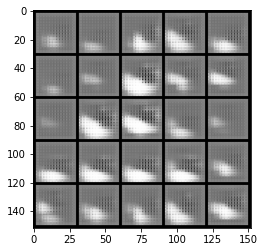

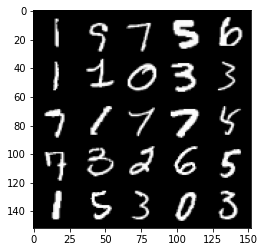

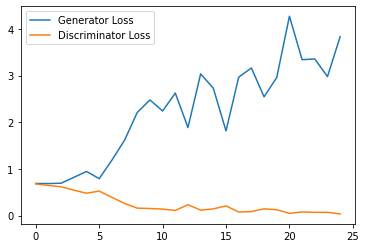

Step 1000: Generator loss: 3.9623011384010316, discriminator loss: 0.05136849063448608


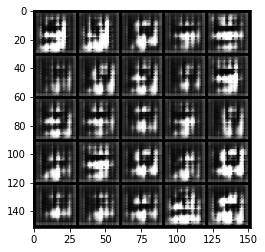

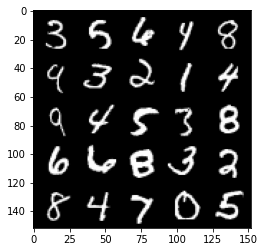

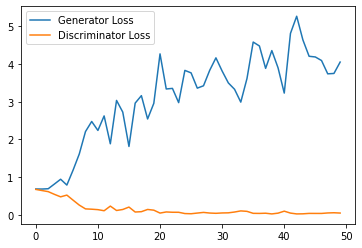

Step 1500: Generator loss: 3.3680934400558473, discriminator loss: 0.1029323808848858


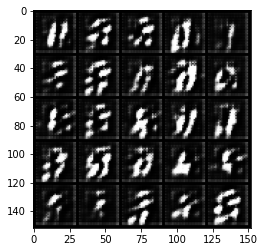

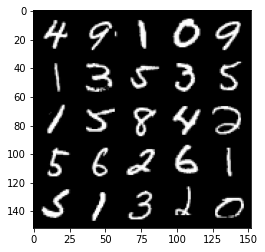

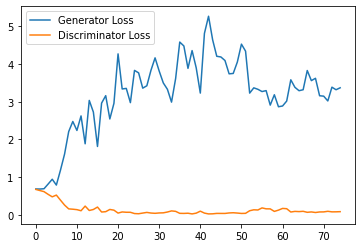

Step 2000: Generator loss: 2.5447427315711977, discriminator loss: 0.24204214471578597


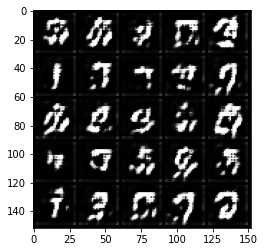

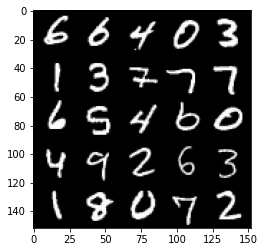

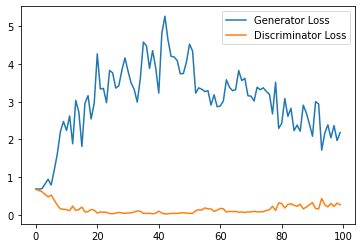

Step 2500: Generator loss: 2.1045157361030578, discriminator loss: 0.3180465543270111


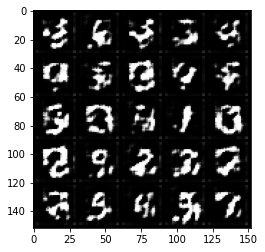

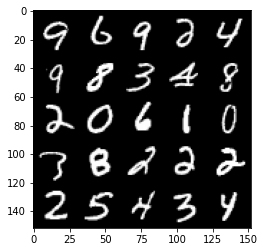

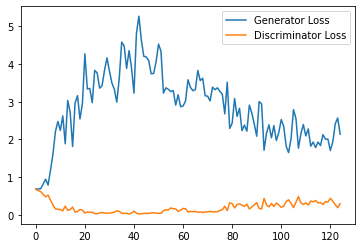

Step 3000: Generator loss: 2.0051902124881744, discriminator loss: 0.32440198203921317


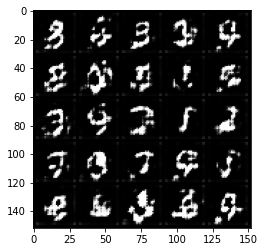

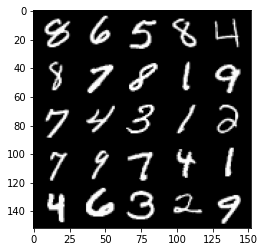

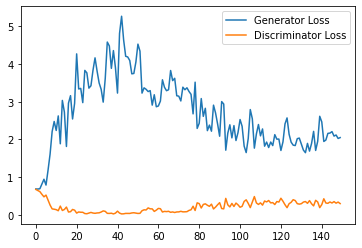

Step 3500: Generator loss: 2.015816449165344, discriminator loss: 0.3266907151341438


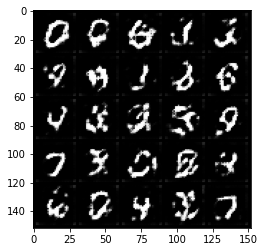

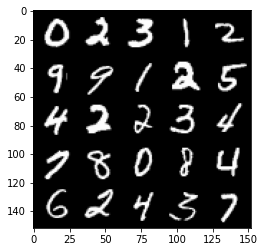

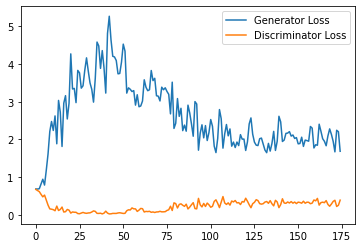

Step 4000: Generator loss: 1.840995361328125, discriminator loss: 0.3147359275221825


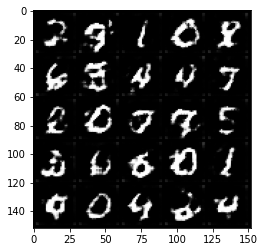

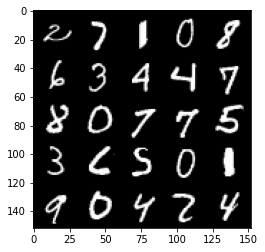

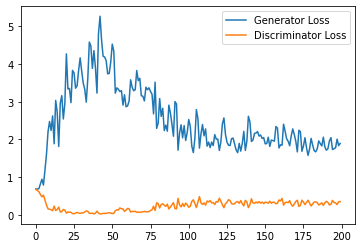

Step 4500: Generator loss: 1.9355460543632508, discriminator loss: 0.33389040306210516


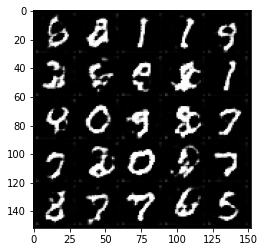

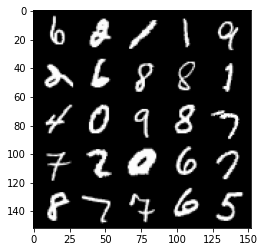

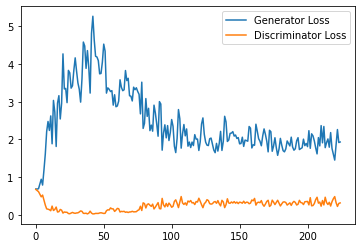

Step 5000: Generator loss: 1.7556954329013825, discriminator loss: 0.3695607197880745


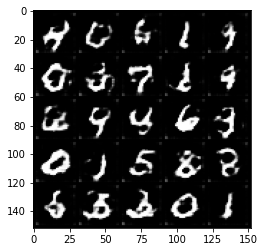

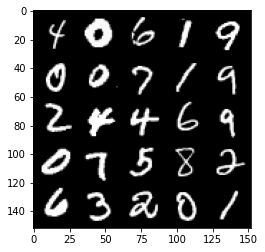

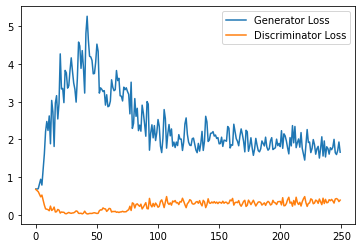

Step 5500: Generator loss: 1.6820221849679946, discriminator loss: 0.4148802751302719


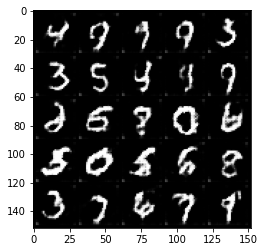

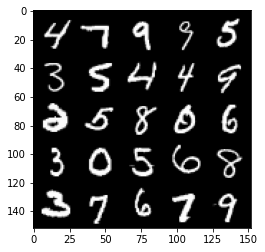

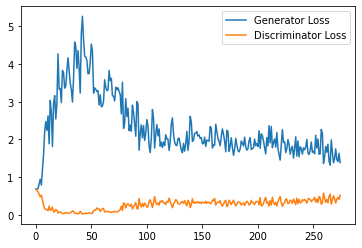

Step 6000: Generator loss: 1.6861994386911392, discriminator loss: 0.45099103516340255


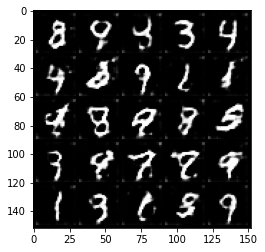

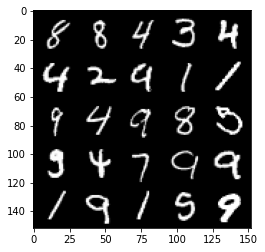

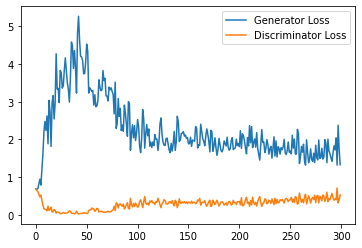

Step 6500: Generator loss: 1.511011670589447, discriminator loss: 0.4671595060825348


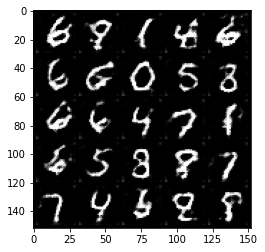

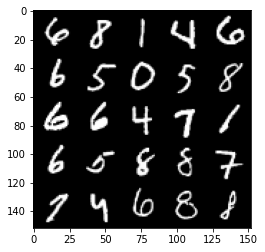

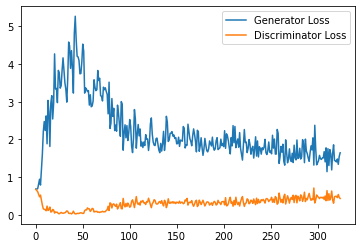

Step 7000: Generator loss: 1.4599444271326065, discriminator loss: 0.49301265373826025


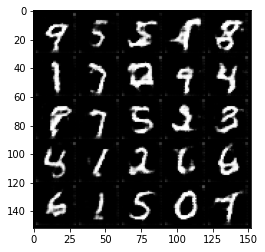

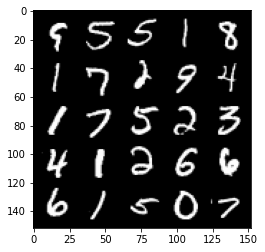

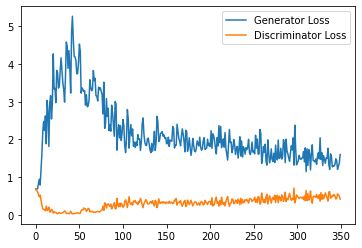

Step 7500: Generator loss: 1.4263254543542863, discriminator loss: 0.4903142867088318


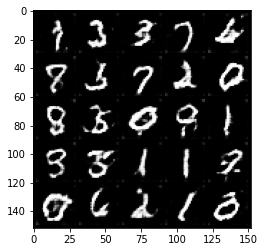

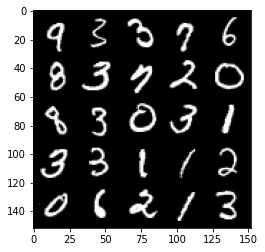

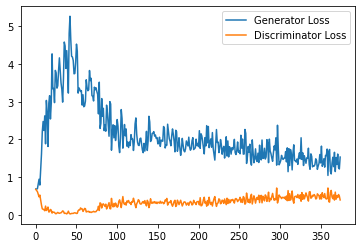

Step 8000: Generator loss: 1.3514921309947967, discriminator loss: 0.5077126346230507


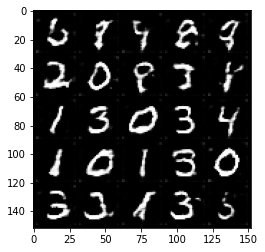

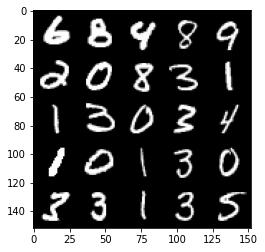

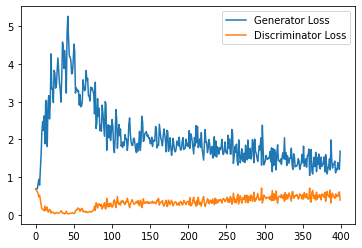

Step 8500: Generator loss: 1.3617395058870316, discriminator loss: 0.5274663844704628


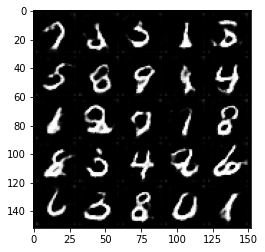

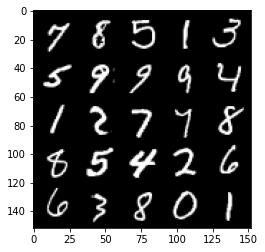

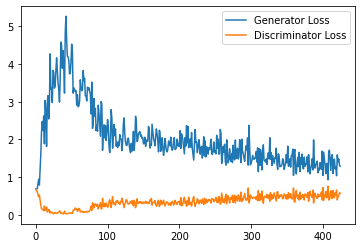

Step 9000: Generator loss: 1.3213903131484985, discriminator loss: 0.5232253291606903


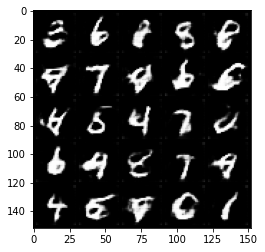

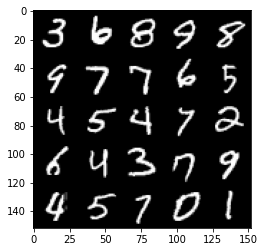

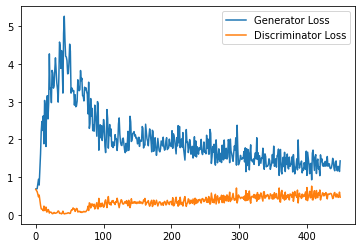

Step 9500: Generator loss: 1.293978280544281, discriminator loss: 0.5069800931811332


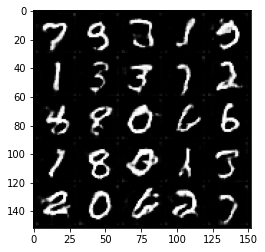

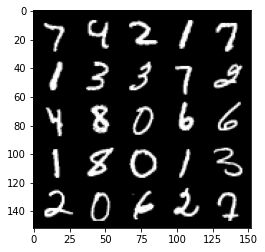

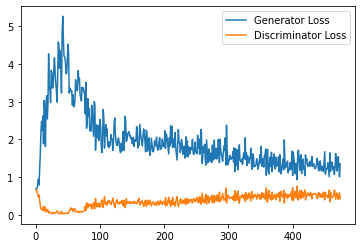

Step 10000: Generator loss: 1.2661562988758086, discriminator loss: 0.5355797086954117


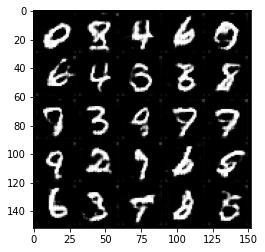

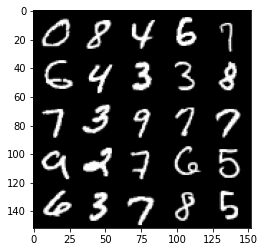

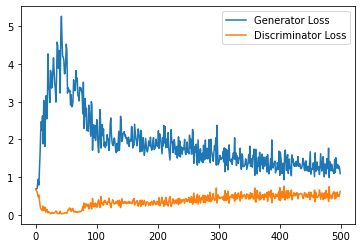

Step 10500: Generator loss: 1.2405667009353638, discriminator loss: 0.527913493514061


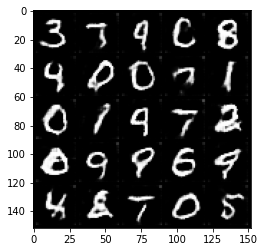

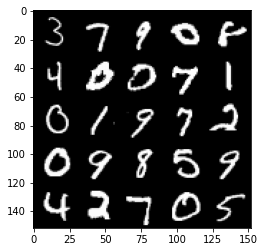

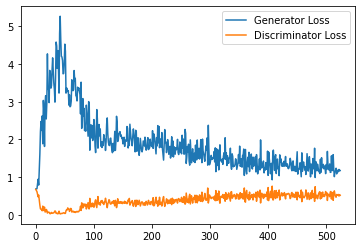

Step 11000: Generator loss: 1.2657554559707642, discriminator loss: 0.5376425961256027


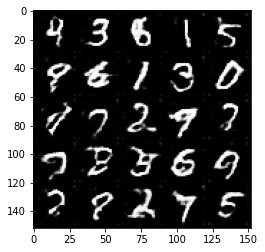

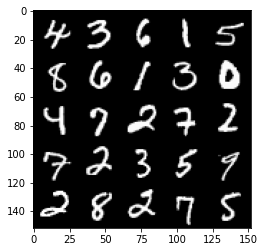

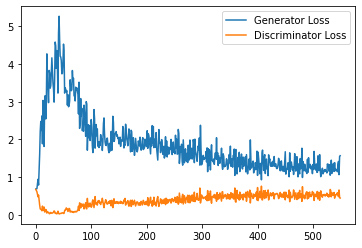

Step 11500: Generator loss: 1.2318681416511537, discriminator loss: 0.5538323706388474


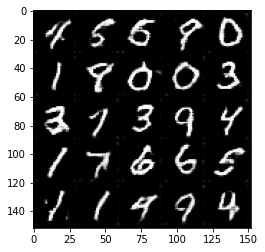

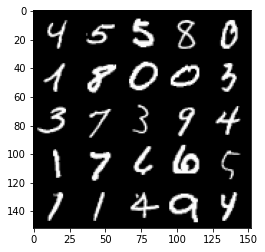

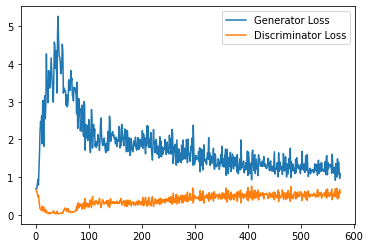

Step 12000: Generator loss: 1.1827301615476609, discriminator loss: 0.5408470010757447


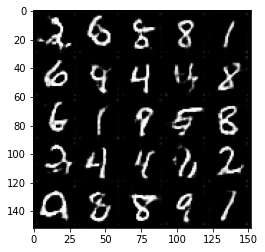

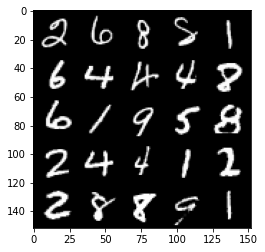

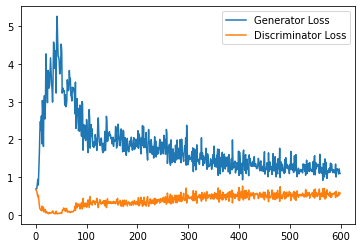

Step 12500: Generator loss: 1.2152290471792222, discriminator loss: 0.5439668986201286


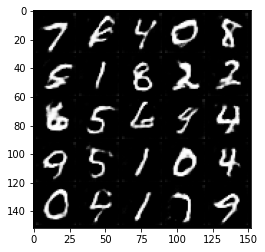

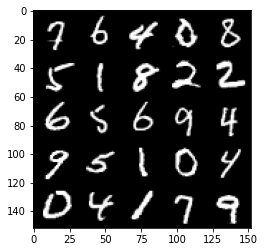

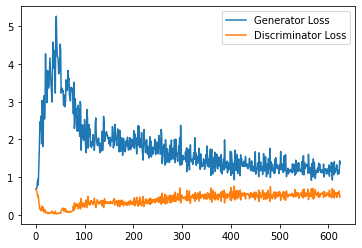

Step 13000: Generator loss: 1.1748913189172745, discriminator loss: 0.5555188626646995


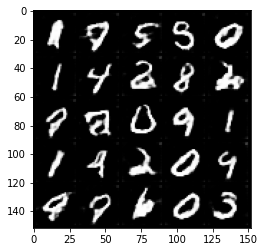

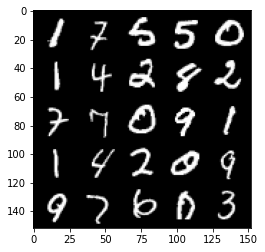

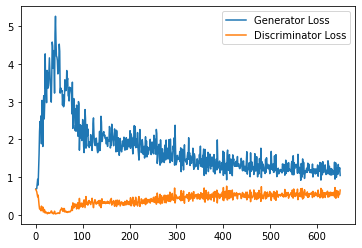

Step 13500: Generator loss: 1.1853109477758408, discriminator loss: 0.5554088026881218


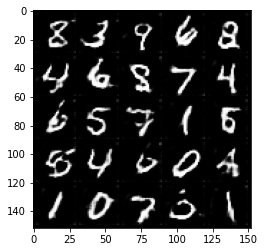

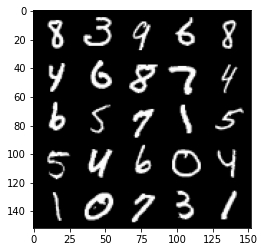

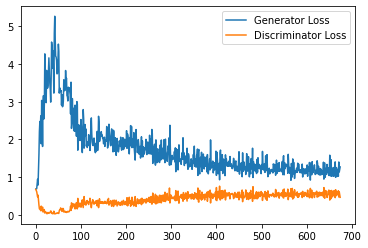

Step 14000: Generator loss: 1.158270403623581, discriminator loss: 0.5630583562850953


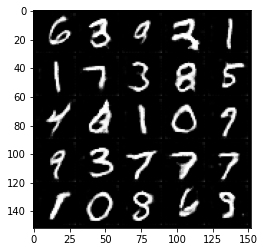

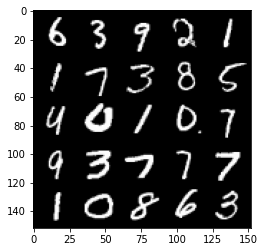

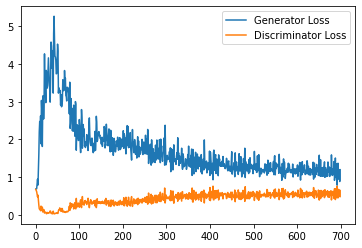

Step 14500: Generator loss: 1.1091542603969573, discriminator loss: 0.5668937889933586


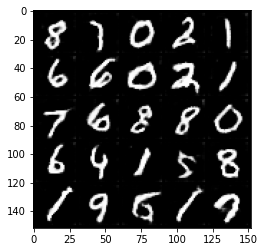

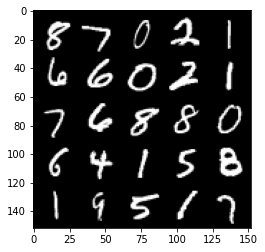

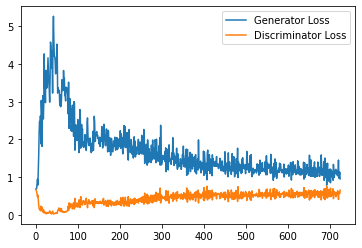

Step 15000: Generator loss: 1.1143117587566376, discriminator loss: 0.5575721237659454


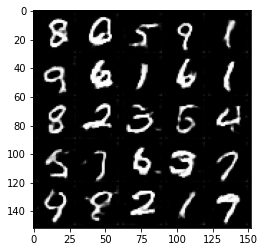

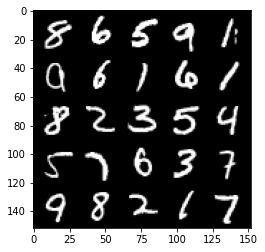

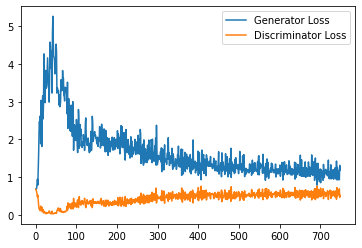

Step 15500: Generator loss: 1.1509467405080795, discriminator loss: 0.5687124932408333


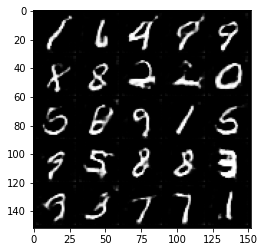

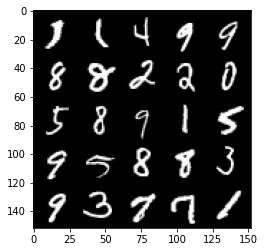

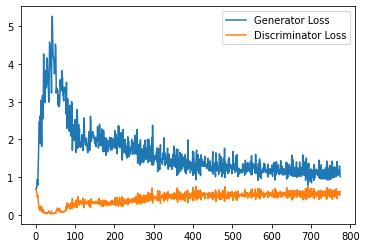

Step 16000: Generator loss: 1.1213047105073928, discriminator loss: 0.5640556573867798


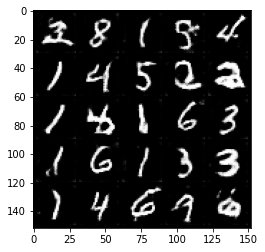

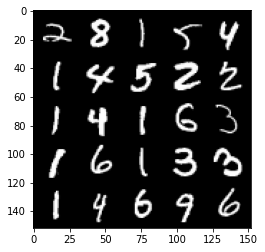

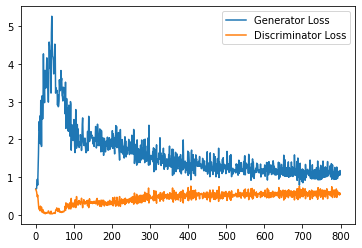

Step 16500: Generator loss: 1.1188407896757127, discriminator loss: 0.5683348806500435


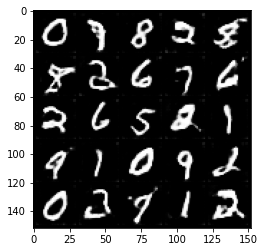

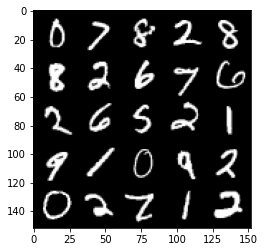

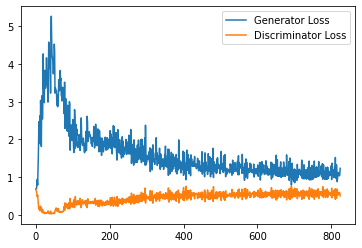

Step 17000: Generator loss: 1.1125763683319092, discriminator loss: 0.5675114120841026


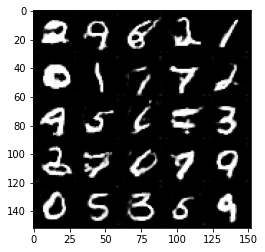

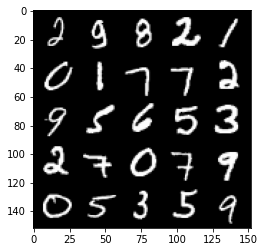

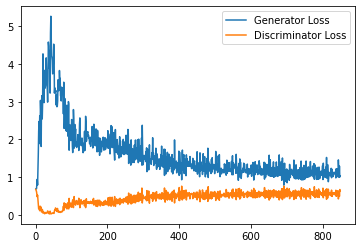

Step 17500: Generator loss: 1.1213065366744994, discriminator loss: 0.5637313603758812


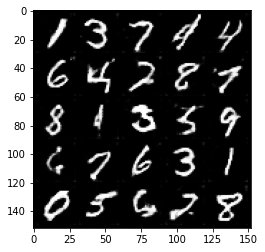

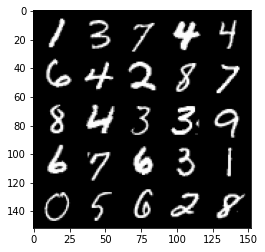

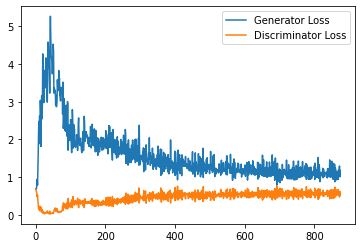

Step 18000: Generator loss: 1.1357561379671097, discriminator loss: 0.5672735075354576


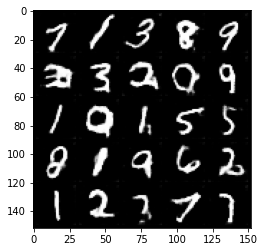

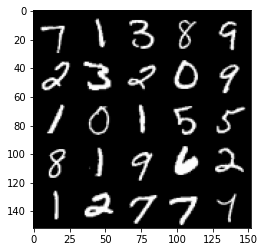

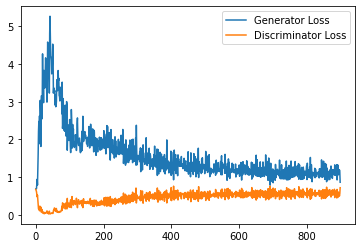

Step 18500: Generator loss: 1.1012643427848816, discriminator loss: 0.5676065245866776


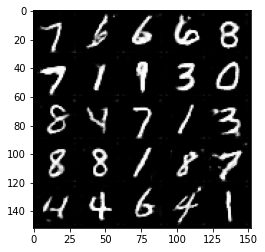

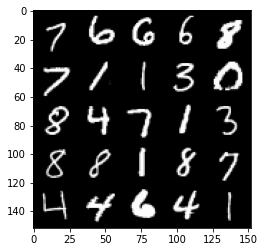

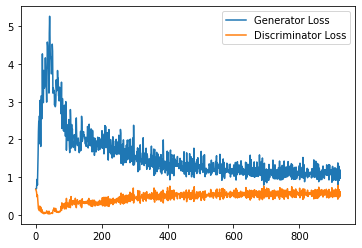

Step 19000: Generator loss: 1.0789610050916671, discriminator loss: 0.5623187781572342


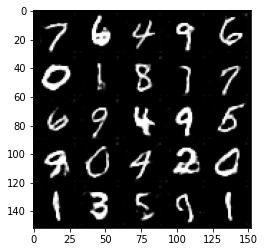

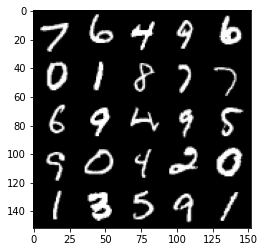

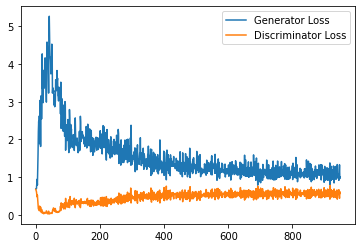

Step 19500: Generator loss: 1.1010409879684449, discriminator loss: 0.5608514190912247


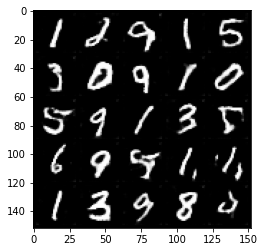

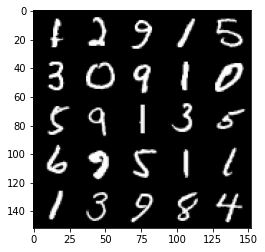

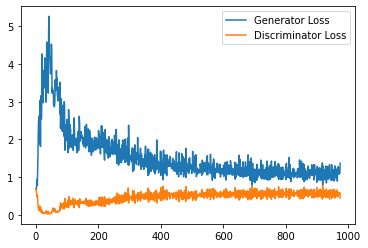

Step 20000: Generator loss: 1.1028976641893387, discriminator loss: 0.564923988699913


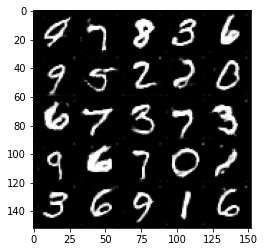

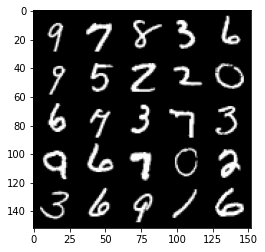

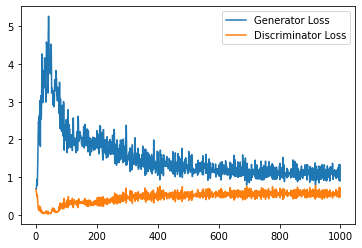

Step 20500: Generator loss: 1.1084620324373244, discriminator loss: 0.5604173277616501


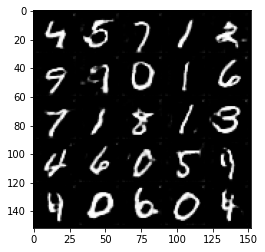

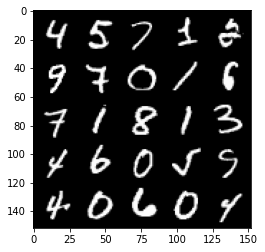

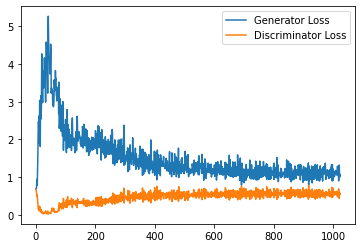

Step 21000: Generator loss: 1.096984214067459, discriminator loss: 0.5609598965644836


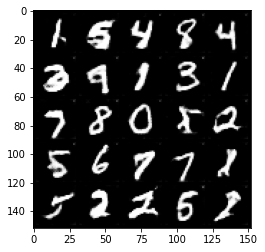

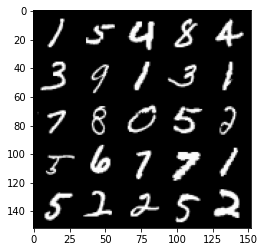

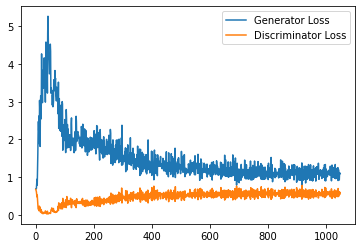

Step 21500: Generator loss: 1.0683741091489791, discriminator loss: 0.5626369903087616


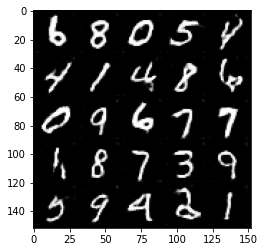

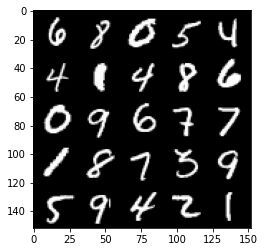

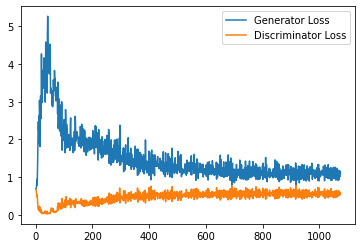

Step 22000: Generator loss: 1.1166770734786988, discriminator loss: 0.5533055557608605


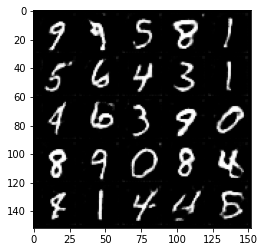

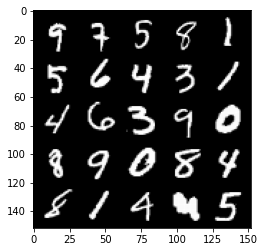

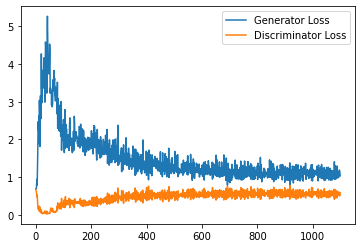

Step 22500: Generator loss: 1.0861683963537216, discriminator loss: 0.5738829708695412


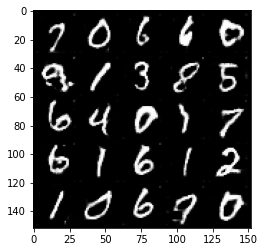

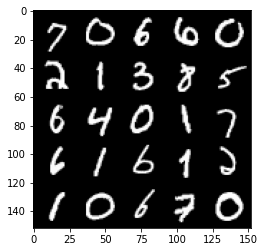

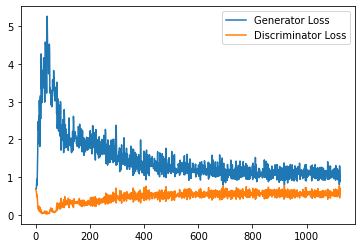

Step 23000: Generator loss: 1.106852549314499, discriminator loss: 0.5623830424547196


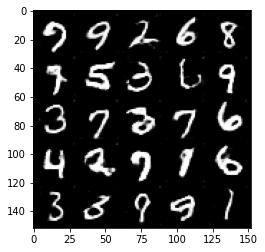

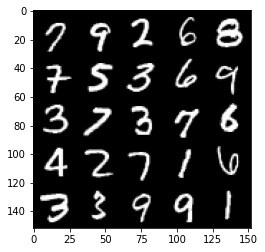

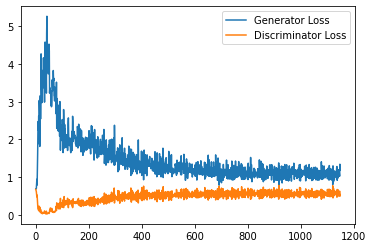

Step 23500: Generator loss: 1.076342346072197, discriminator loss: 0.567676248550415


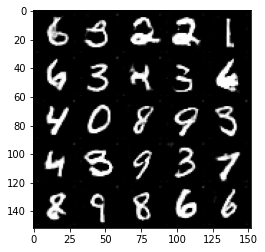

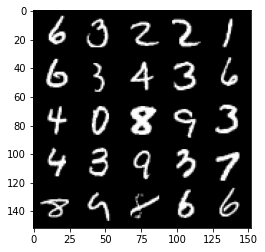

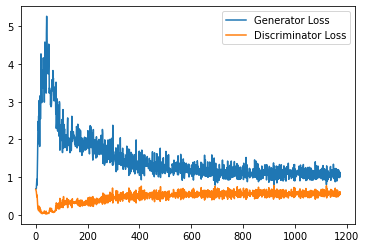

Step 24000: Generator loss: 1.0593205560445786, discriminator loss: 0.5654110735058785


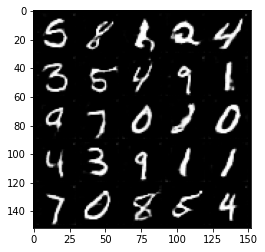

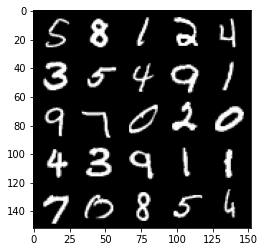

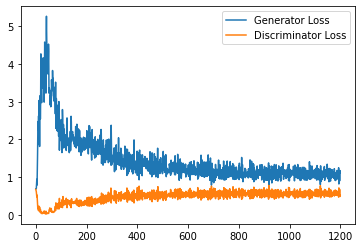

Step 24500: Generator loss: 1.0808607436418534, discriminator loss: 0.571754763185978


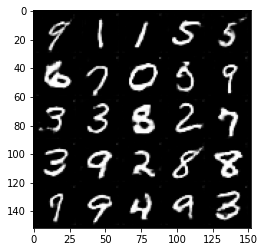

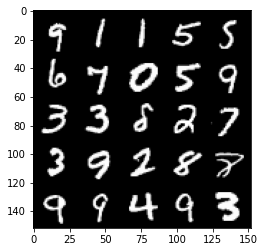

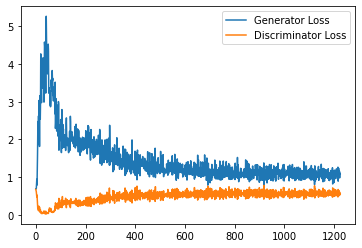

Step 25000: Generator loss: 1.0677131789922714, discriminator loss: 0.5696047073602677


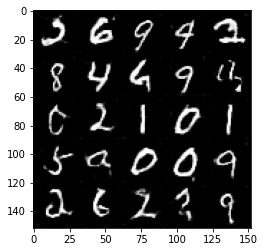

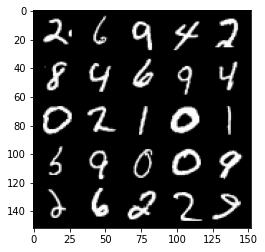

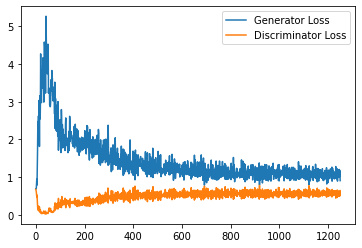

Step 25500: Generator loss: 1.0913513768911363, discriminator loss: 0.5676319169998169


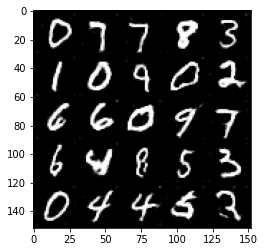

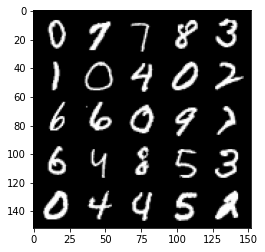

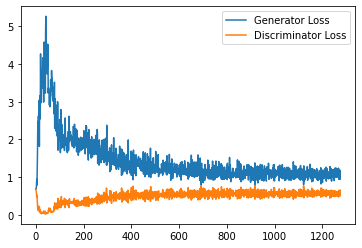

Step 26000: Generator loss: 1.088192336320877, discriminator loss: 0.567583314538002


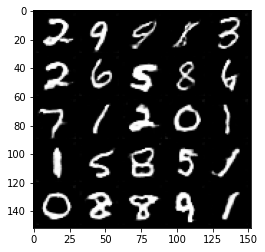

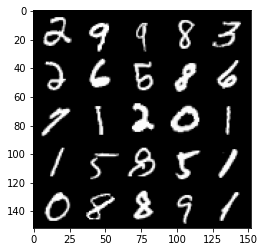

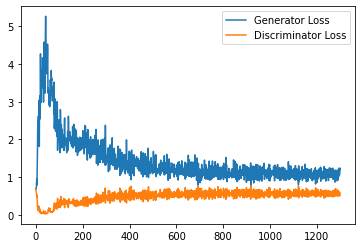

Step 26500: Generator loss: 1.0630989947319032, discriminator loss: 0.5760309327244758


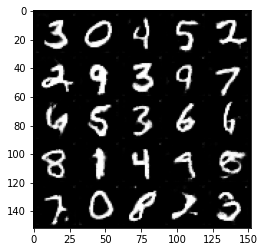

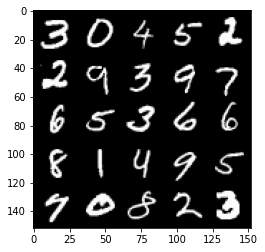

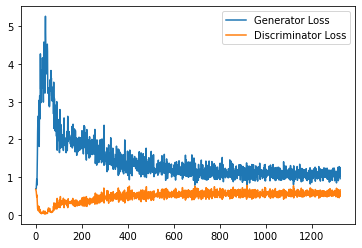

Step 27000: Generator loss: 1.070924371600151, discriminator loss: 0.5698677706122398


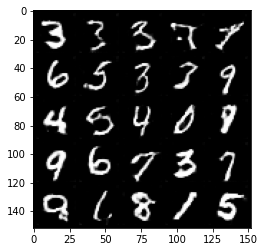

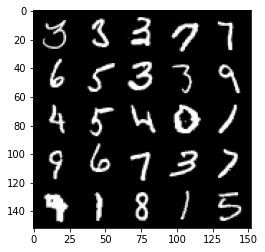

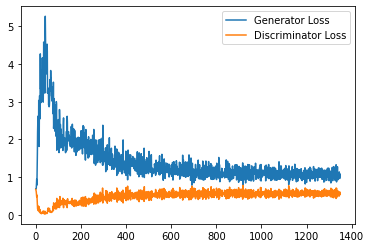

Step 27500: Generator loss: 1.0593978698253632, discriminator loss: 0.5678142599463463


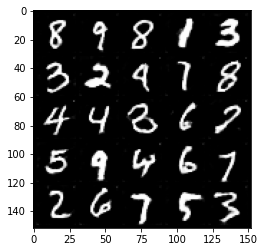

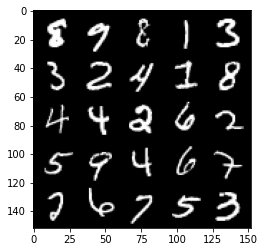

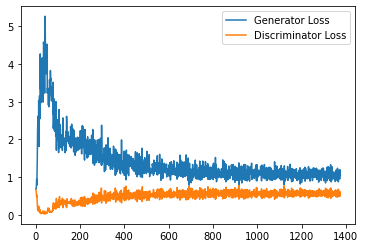

Step 28000: Generator loss: 1.0655368534326553, discriminator loss: 0.5700710599422455


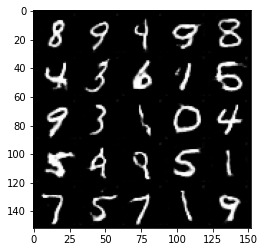

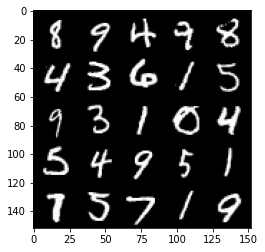

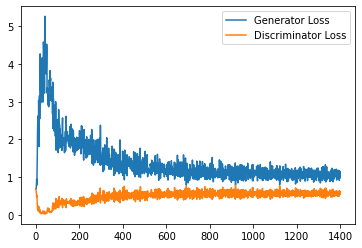

Step 28500: Generator loss: 1.0802750446796416, discriminator loss: 0.5774842156767845


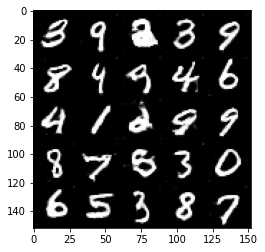

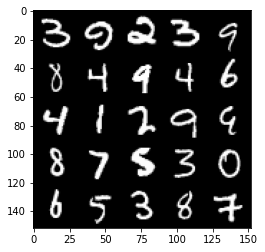

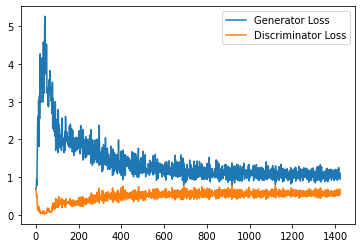

Step 29000: Generator loss: 1.0680937871932983, discriminator loss: 0.5695889078378678


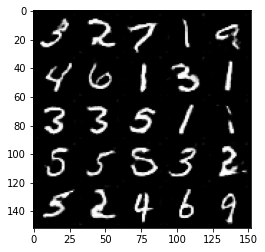

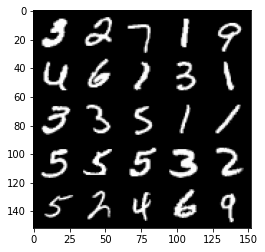

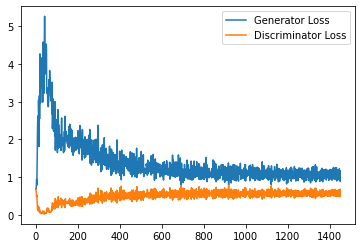

Step 29500: Generator loss: 1.0780179286003113, discriminator loss: 0.5740541129112243


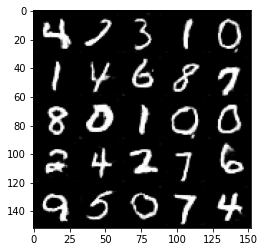

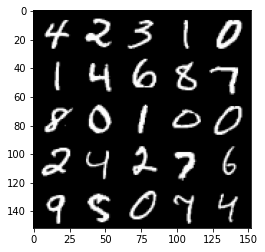

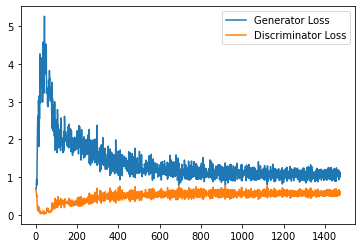

Step 30000: Generator loss: 1.0917946109771728, discriminator loss: 0.5711322181820869


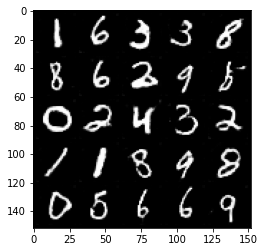

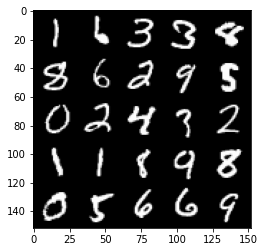

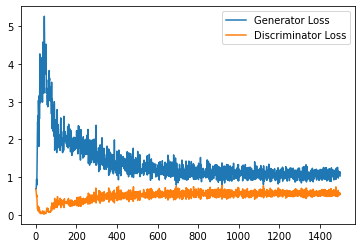

Step 30500: Generator loss: 1.0801981241703034, discriminator loss: 0.5642524147033692


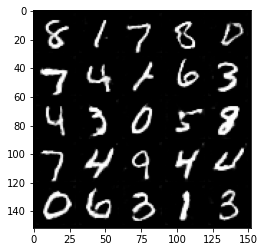

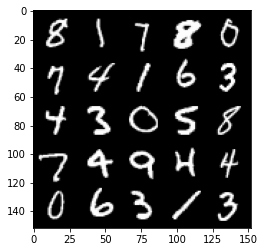

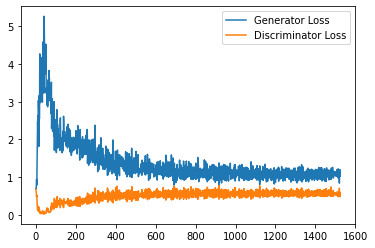

Step 31000: Generator loss: 1.0637033100128175, discriminator loss: 0.5746740342378617


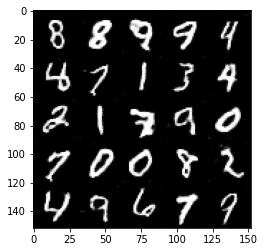

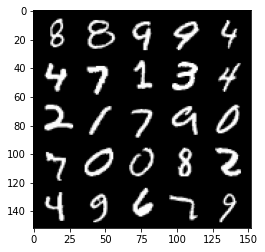

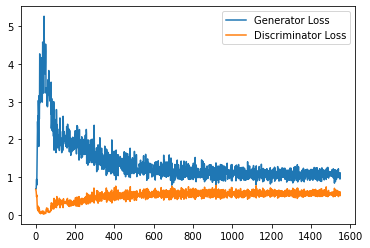

Step 31500: Generator loss: 1.0720760246515275, discriminator loss: 0.5695901566743851


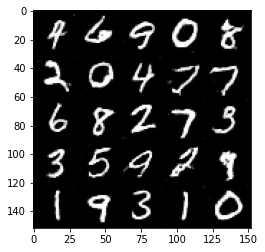

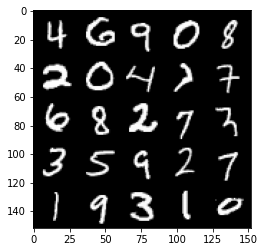

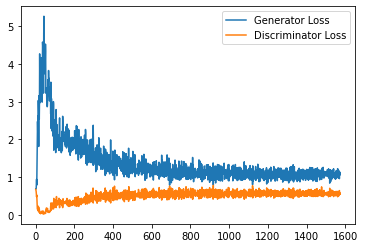

Step 32000: Generator loss: 1.0674809575080872, discriminator loss: 0.5726464581489563


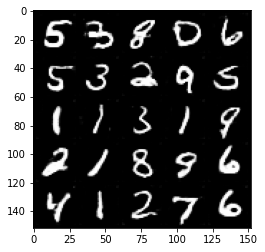

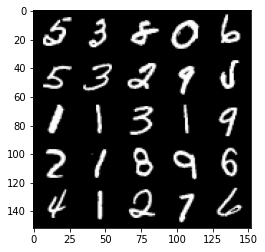

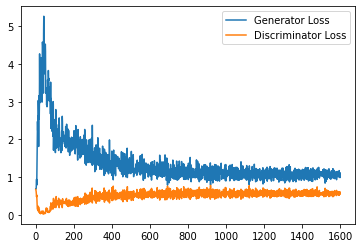

Step 32500: Generator loss: 1.0817201769351958, discriminator loss: 0.5743797873854637


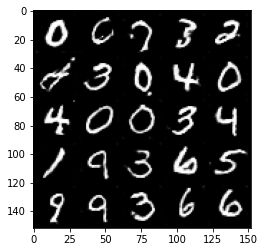

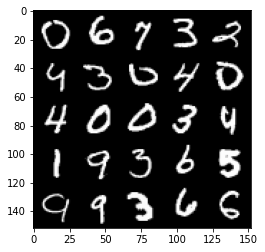

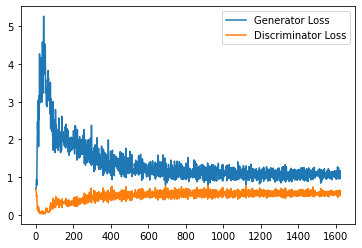

Step 33000: Generator loss: 1.0650939013957976, discriminator loss: 0.5752244502305984


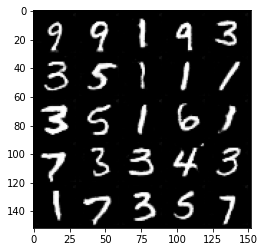

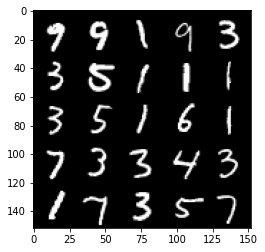

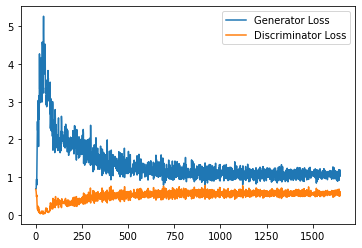

Step 33500: Generator loss: 1.0530416787862777, discriminator loss: 0.5727493854761123


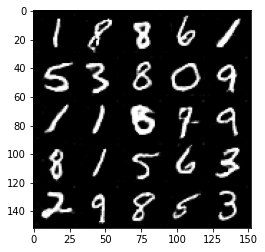

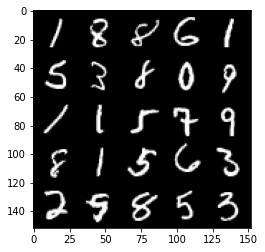

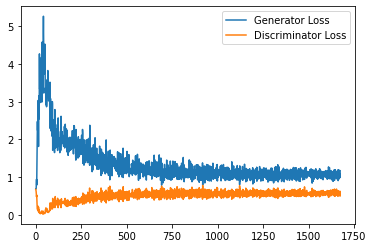

Step 34000: Generator loss: 1.057174494624138, discriminator loss: 0.5846038101911545


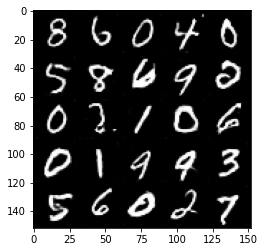

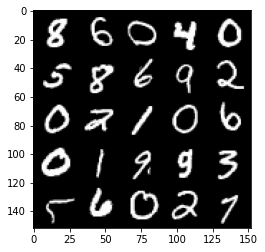

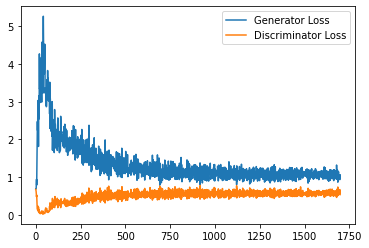

Step 34500: Generator loss: 1.0579375101327897, discriminator loss: 0.5786712683439255


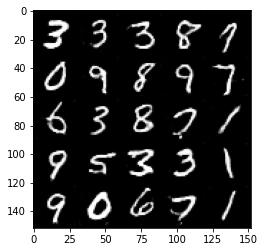

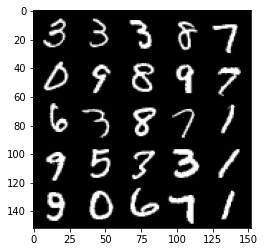

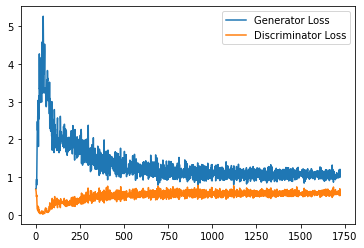

Step 35000: Generator loss: 1.073990331888199, discriminator loss: 0.5851956521272659


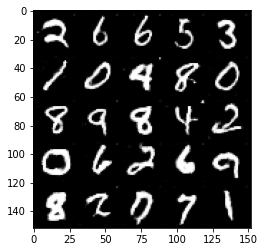

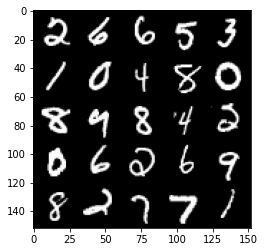

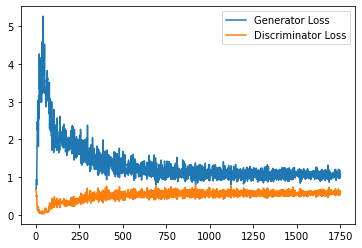

Step 35500: Generator loss: 1.050808440208435, discriminator loss: 0.584708882689476


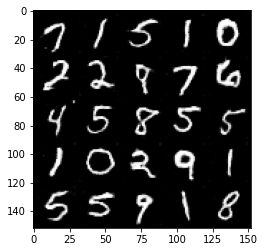

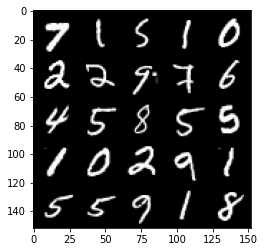

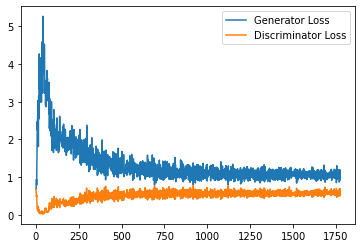

Step 36000: Generator loss: 1.0388133713006973, discriminator loss: 0.578150114774704


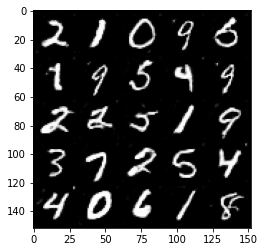

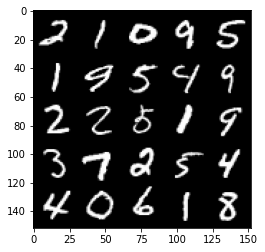

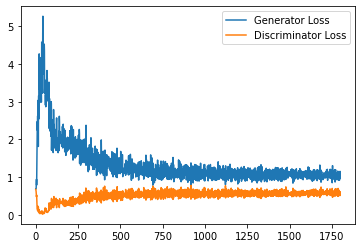

Step 36500: Generator loss: 1.063008051276207, discriminator loss: 0.5866398308873176


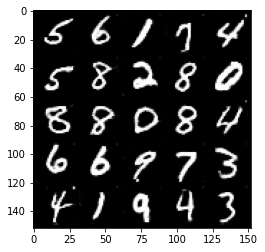

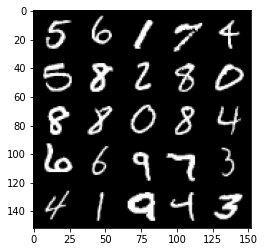

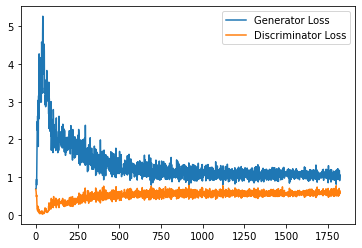

Step 37000: Generator loss: 1.0325087502002717, discriminator loss: 0.5842185198068619


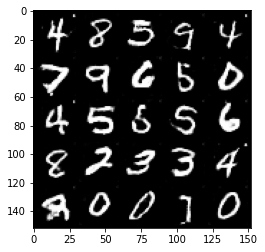

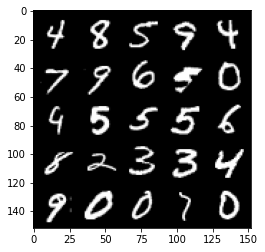

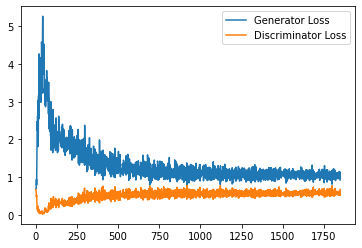

Step 37500: Generator loss: 1.0421232570409775, discriminator loss: 0.5828447417616844


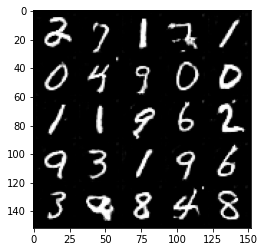

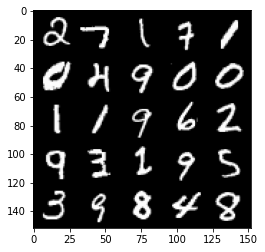

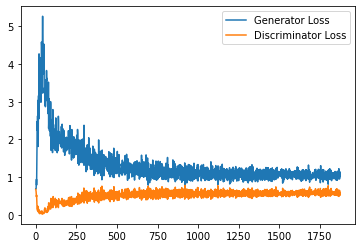

Step 38000: Generator loss: 1.0364866743087768, discriminator loss: 0.5844669840335845


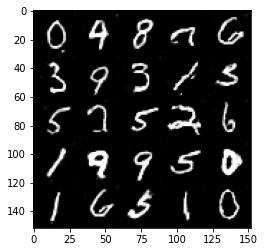

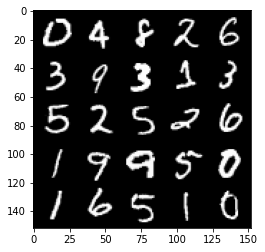

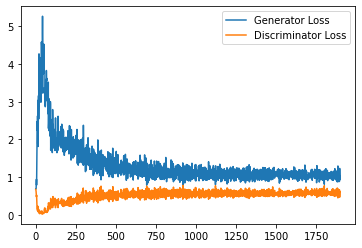

Step 38500: Generator loss: 1.042504082918167, discriminator loss: 0.5817627763748169


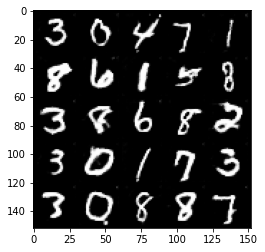

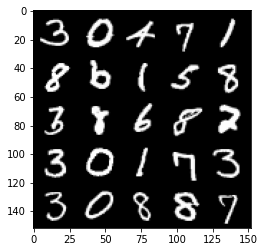

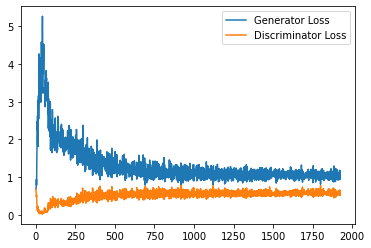

Step 39000: Generator loss: 1.0381833931207658, discriminator loss: 0.5869362911581993


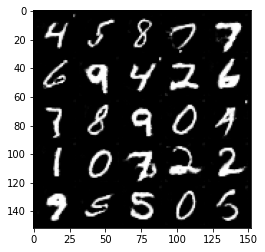

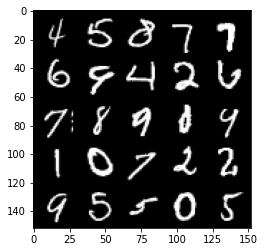

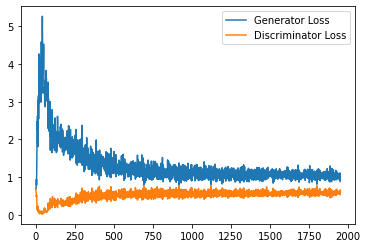

Step 39500: Generator loss: 1.0436170870065689, discriminator loss: 0.5799314268827438


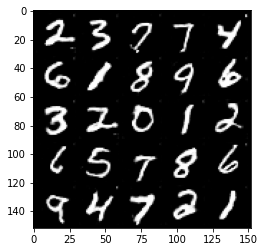

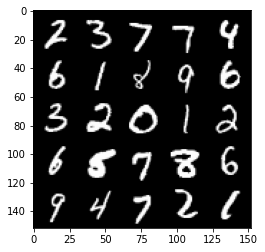

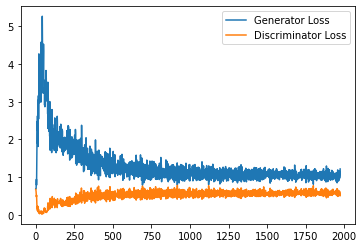

Step 40000: Generator loss: 1.0571068210601806, discriminator loss: 0.5890251780748368


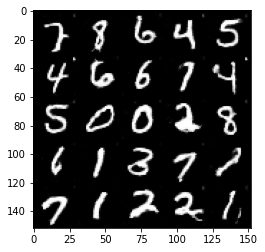

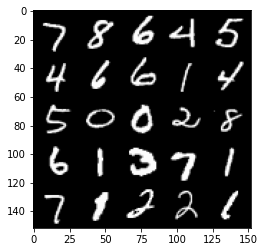

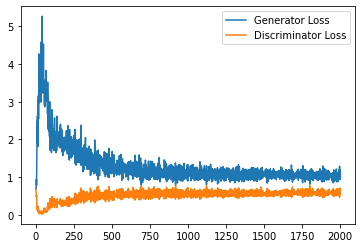

Step 40500: Generator loss: 1.0509075040817262, discriminator loss: 0.581266465306282


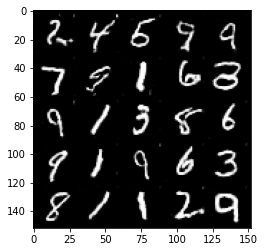

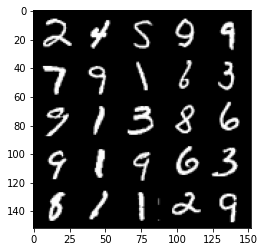

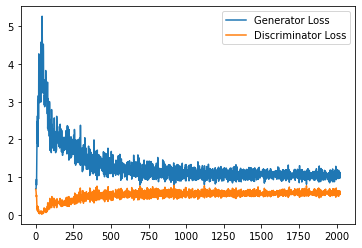

Step 41000: Generator loss: 1.057655219912529, discriminator loss: 0.5797445005178452


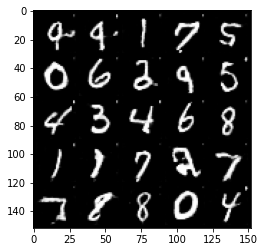

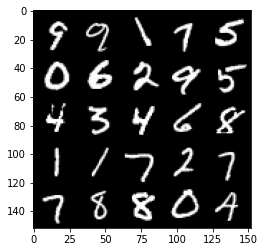

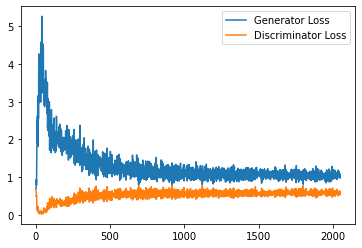

Step 41500: Generator loss: 1.0525281587839126, discriminator loss: 0.5827392632365227


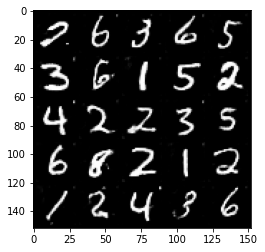

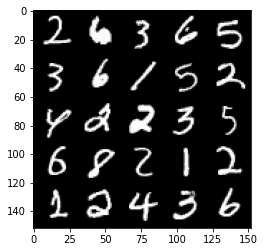

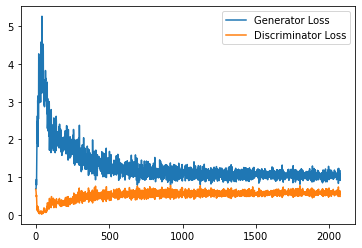

Step 42000: Generator loss: 1.0232395129203797, discriminator loss: 0.5843796653747558


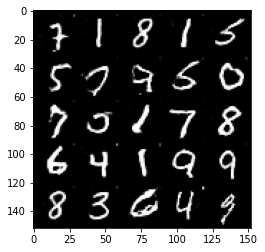

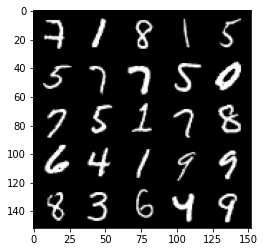

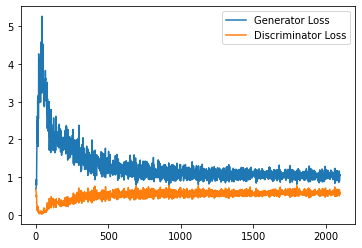

Step 42500: Generator loss: 1.0239276735782623, discriminator loss: 0.5871726563572883


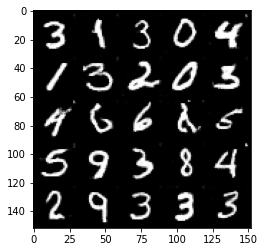

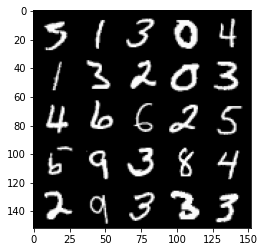

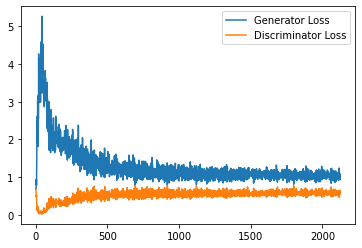

Step 43000: Generator loss: 1.0409539744853973, discriminator loss: 0.584081738948822


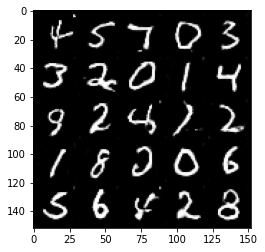

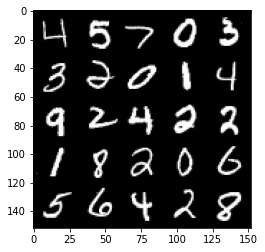

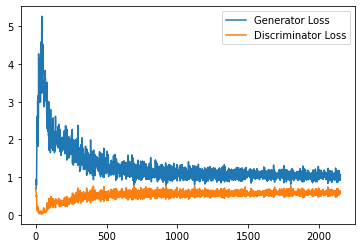

Step 43500: Generator loss: 1.0527041909694672, discriminator loss: 0.5807904545664787


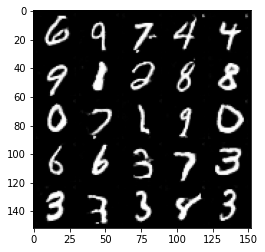

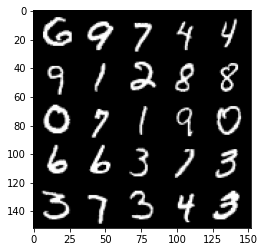

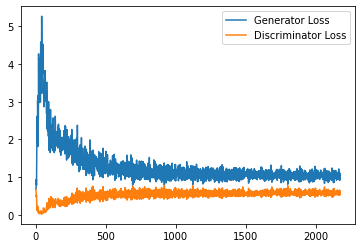

Step 44000: Generator loss: 1.044017065525055, discriminator loss: 0.5858837847709656


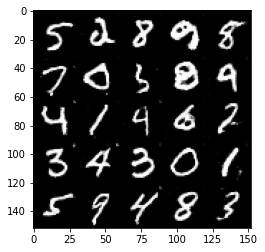

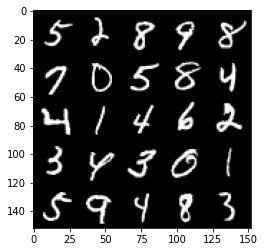

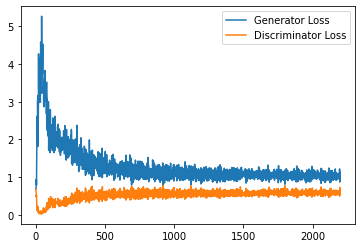

Step 44500: Generator loss: 1.0483545315265657, discriminator loss: 0.5799457321166992


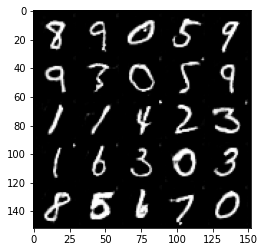

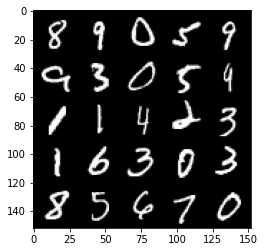

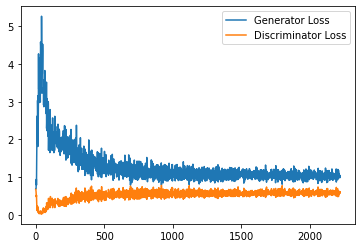

Step 45000: Generator loss: 1.0421790592670441, discriminator loss: 0.576400076687336


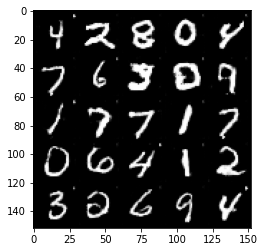

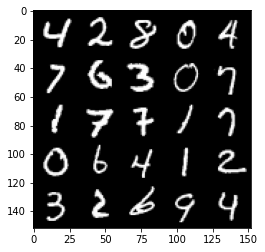

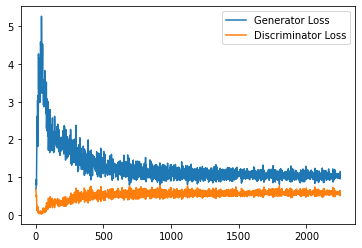

Step 45500: Generator loss: 1.0639246068000794, discriminator loss: 0.5842987850308419


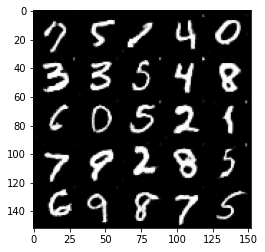

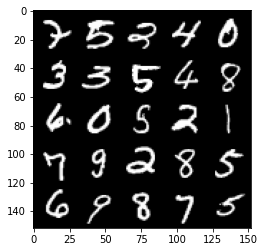

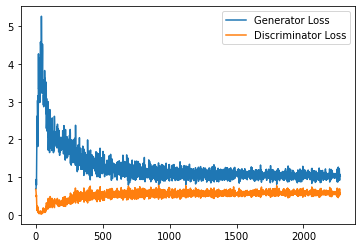

Step 46000: Generator loss: 1.053536841750145, discriminator loss: 0.5792939115166664


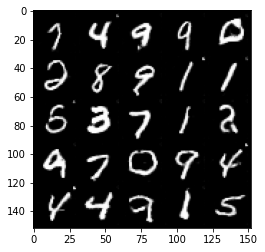

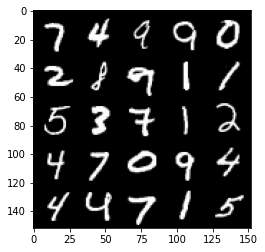

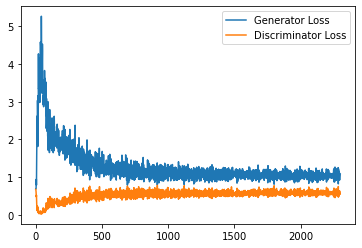

Step 46500: Generator loss: 1.0241235543489455, discriminator loss: 0.5831152067184449


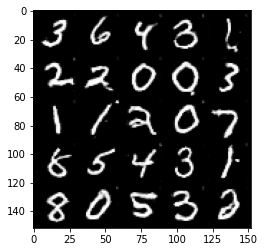

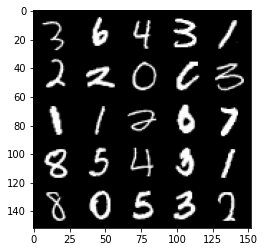

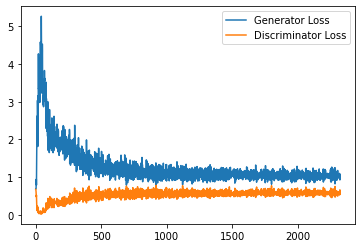

Step 47000: Generator loss: 1.0360294179916383, discriminator loss: 0.5750794149637223


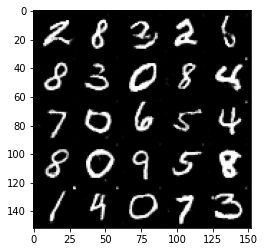

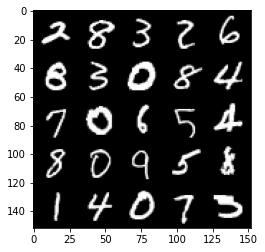

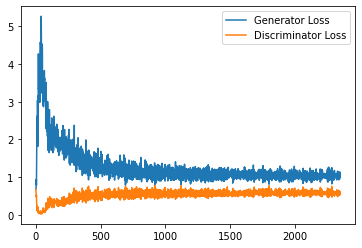

Step 47500: Generator loss: 1.0695384768247604, discriminator loss: 0.5728094716668128


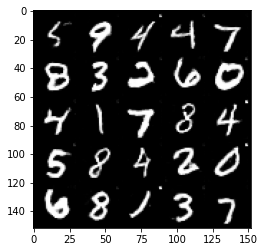

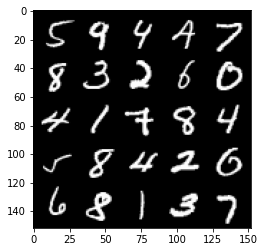

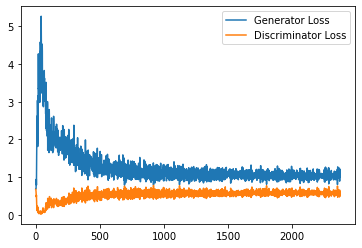

Step 48000: Generator loss: 1.0362485239505768, discriminator loss: 0.5796588245034218


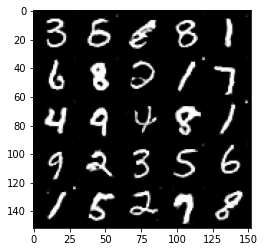

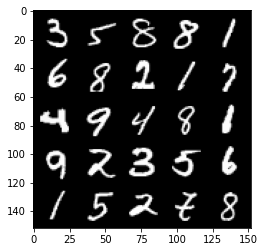

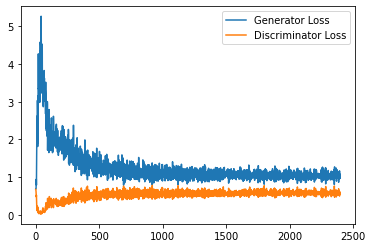

Step 48500: Generator loss: 1.0542720092535018, discriminator loss: 0.5741576920747757


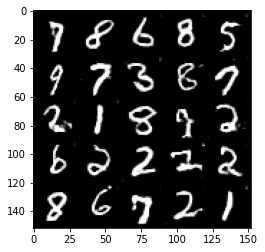

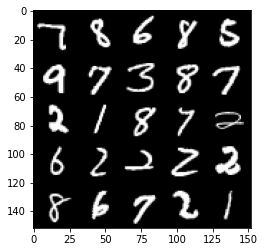

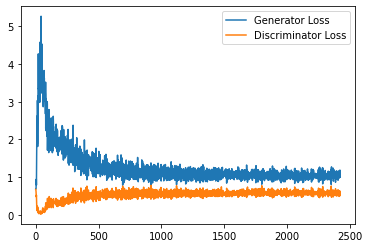

Step 49000: Generator loss: 1.0565191348791123, discriminator loss: 0.5743380184769631


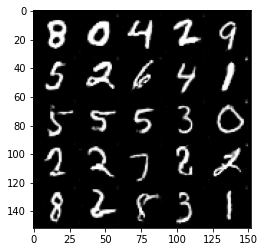

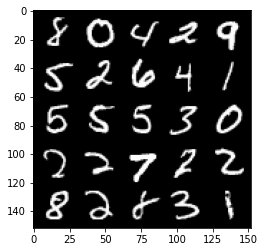

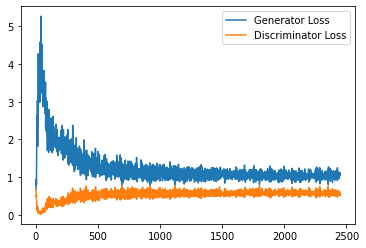

Step 49500: Generator loss: 1.0642407550811768, discriminator loss: 0.5761619974970817


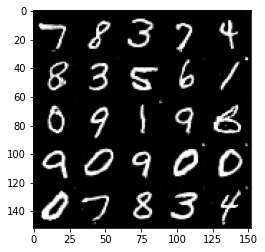

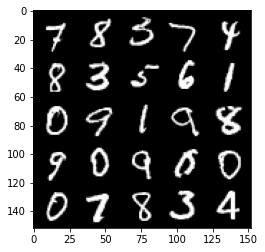

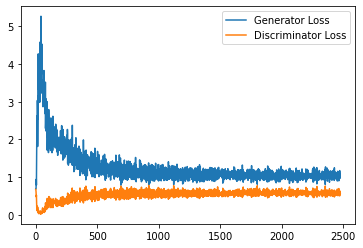

Step 50000: Generator loss: 1.041046622633934, discriminator loss: 0.5845575624704361


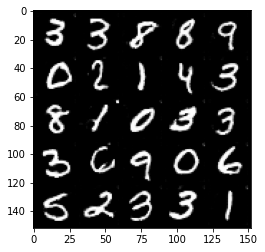

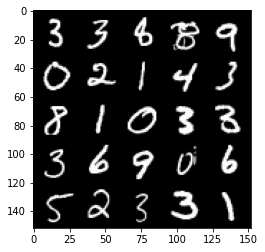

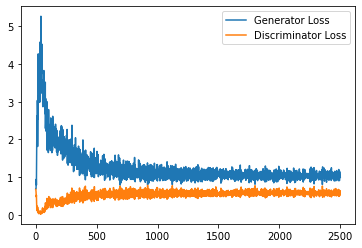

Step 50500: Generator loss: 1.052025342106819, discriminator loss: 0.5705272069573403


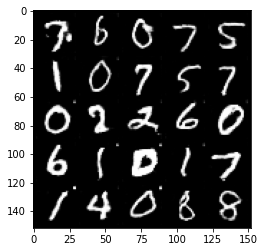

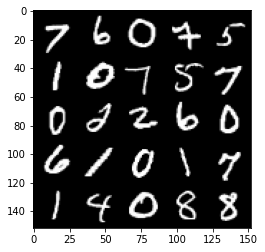

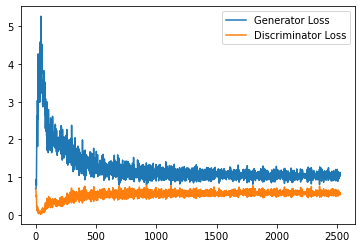

Step 51000: Generator loss: 1.0606392526626587, discriminator loss: 0.5753300161361694


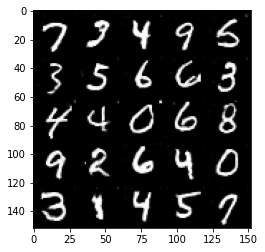

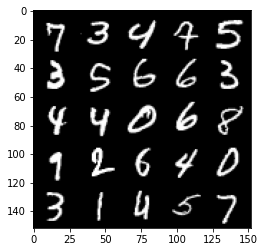

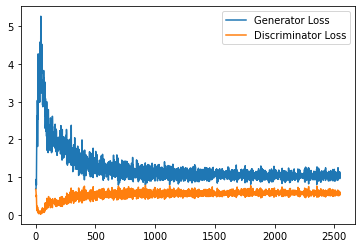

Step 51500: Generator loss: 1.0516558554172515, discriminator loss: 0.5785732326507569


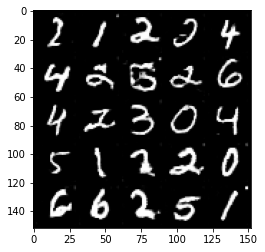

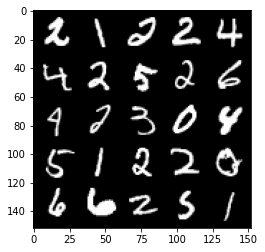

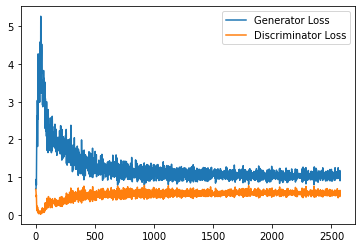

Step 52000: Generator loss: 1.0735188657045365, discriminator loss: 0.5705443086028099


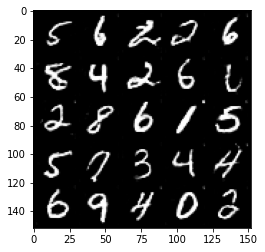

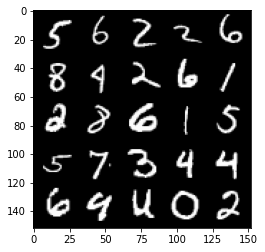

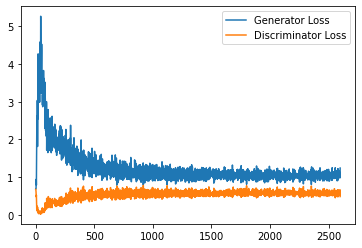

Step 52500: Generator loss: 1.085226935148239, discriminator loss: 0.567924863755703


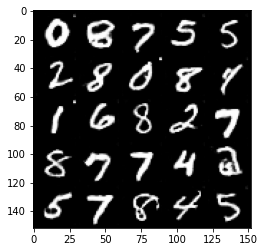

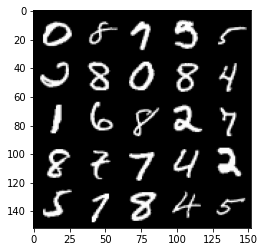

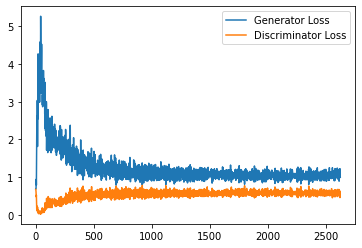

Step 53000: Generator loss: 1.0507182844877243, discriminator loss: 0.574168852686882


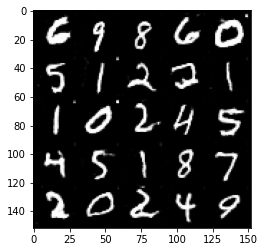

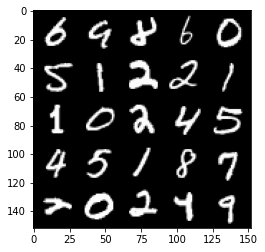

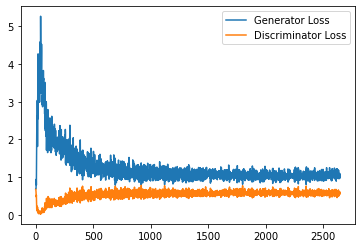

Step 53500: Generator loss: 1.0413441662788392, discriminator loss: 0.5784175209999084


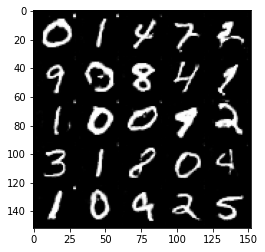

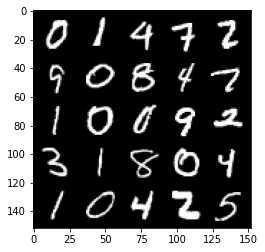

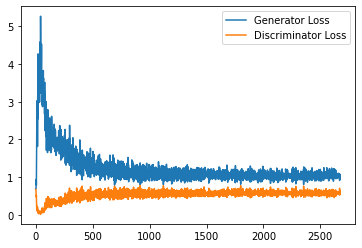

Step 54000: Generator loss: 1.0708775770664216, discriminator loss: 0.5779390408992767


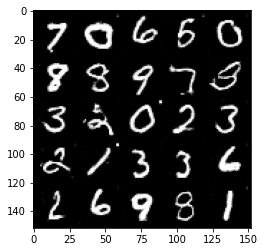

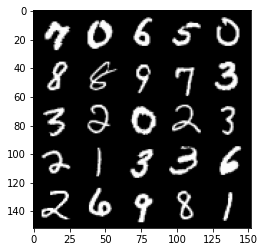

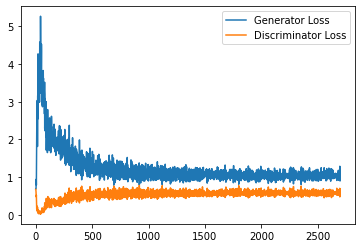

Step 54500: Generator loss: 1.067100266456604, discriminator loss: 0.5663961381316185


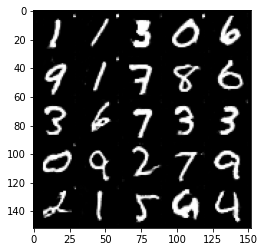

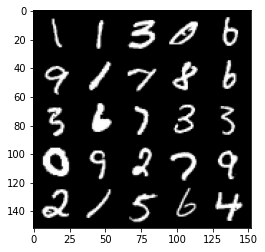

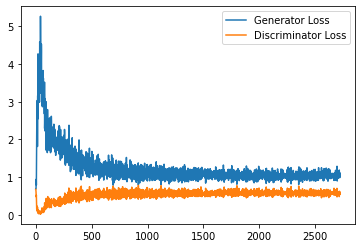

Step 55000: Generator loss: 1.0714700807332993, discriminator loss: 0.5716750884652138


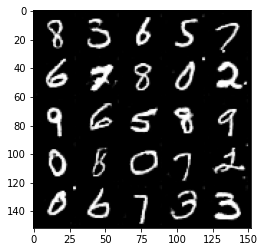

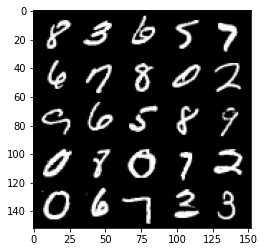

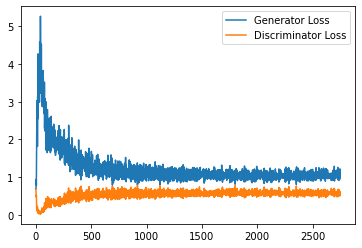

Step 55500: Generator loss: 1.0633373608589172, discriminator loss: 0.5709665576815606


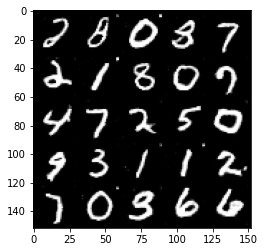

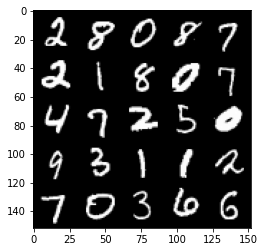

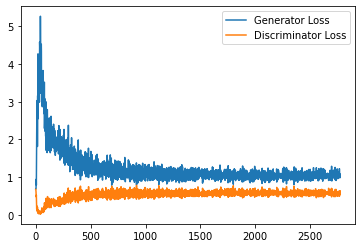

Step 56000: Generator loss: 1.0797334078550338, discriminator loss: 0.564162689447403


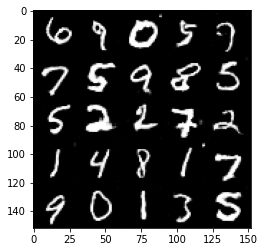

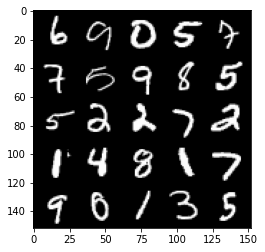

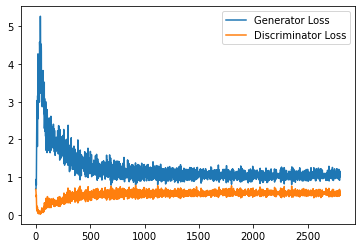

Step 56500: Generator loss: 1.0718975406885147, discriminator loss: 0.5649281377196312


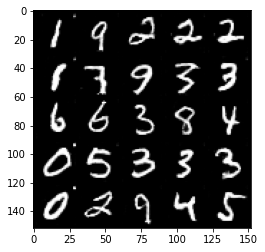

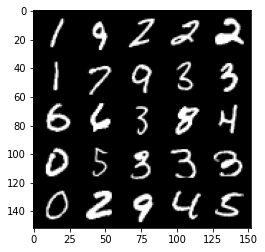

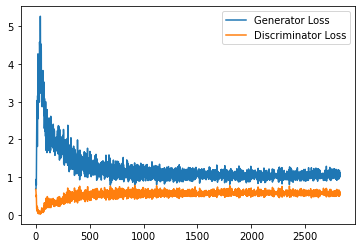

Step 57000: Generator loss: 1.0833620104789734, discriminator loss: 0.5702043182849884


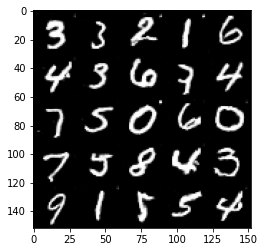

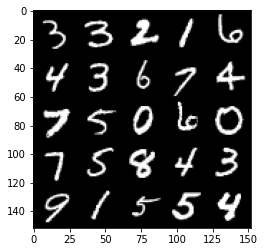

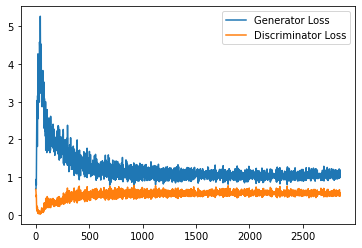

Step 57500: Generator loss: 1.066402801156044, discriminator loss: 0.5731167683601379


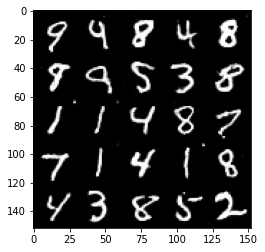

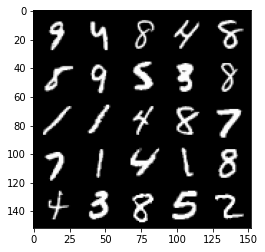

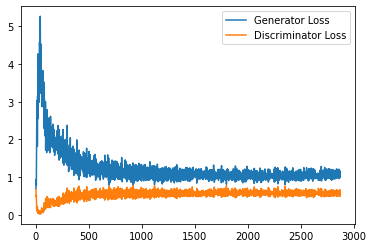

Step 58000: Generator loss: 1.0771931575536728, discriminator loss: 0.5707698503732681


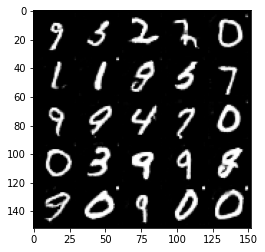

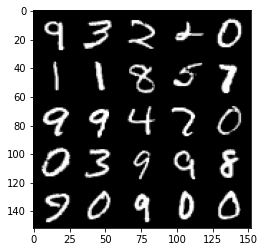

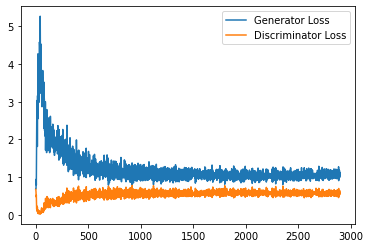

Step 58500: Generator loss: 1.0894083219766617, discriminator loss: 0.5658300588726998


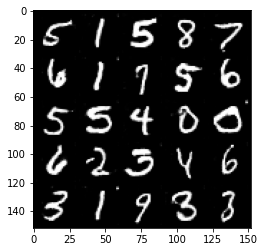

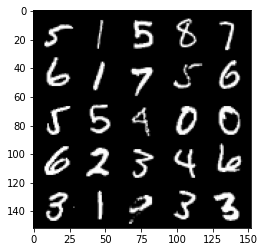

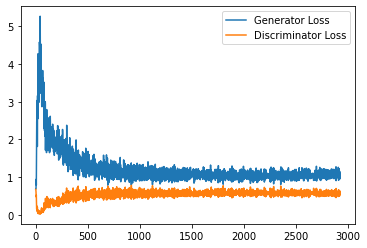

Step 59000: Generator loss: 1.0739151866436005, discriminator loss: 0.5662282302975654


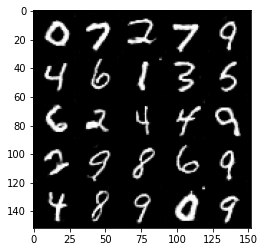

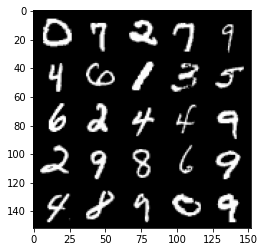

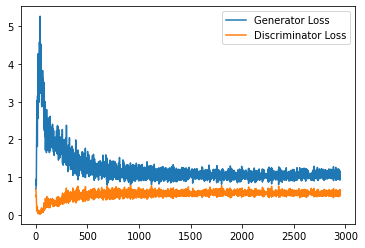

Step 59500: Generator loss: 1.0813755615949632, discriminator loss: 0.5696029010415077


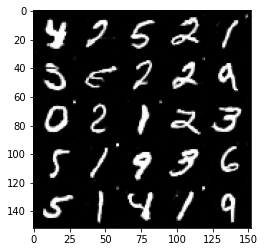

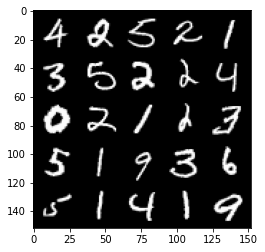

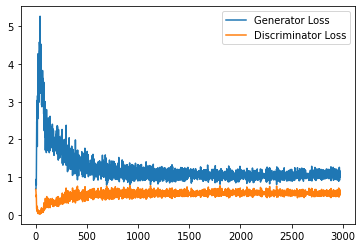

Step 60000: Generator loss: 1.0796179279088973, discriminator loss: 0.5606254273653031


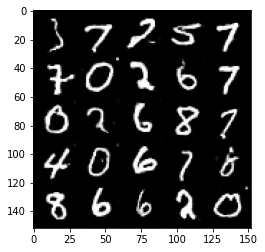

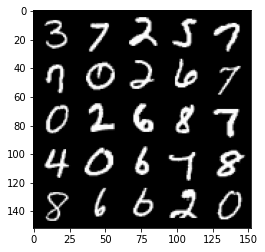

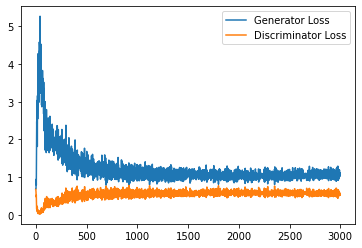

Step 60500: Generator loss: 1.0803798855543136, discriminator loss: 0.5666955261826515


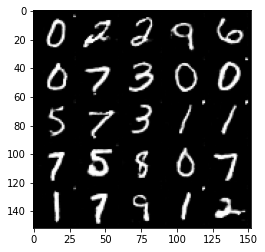

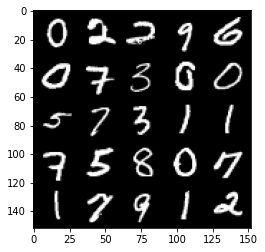

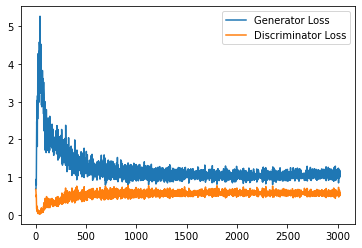

Step 61000: Generator loss: 1.0761928641796112, discriminator loss: 0.5644889287948608


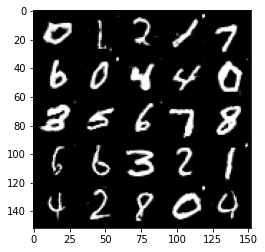

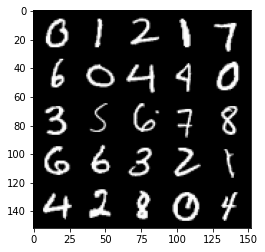

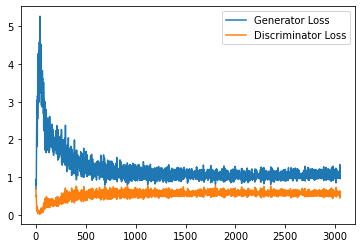

Step 61500: Generator loss: 1.0732641245126724, discriminator loss: 0.567739284992218


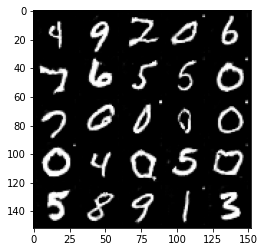

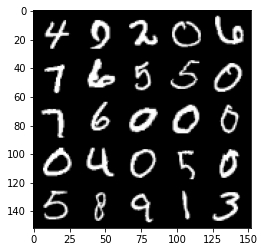

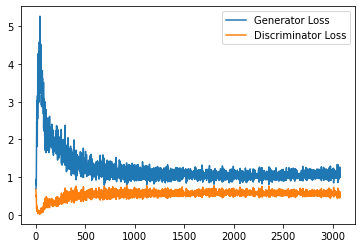

Step 62000: Generator loss: 1.0936615990400314, discriminator loss: 0.5597841291427612


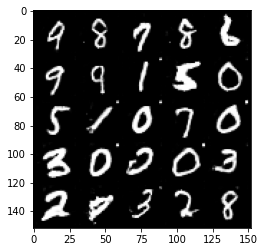

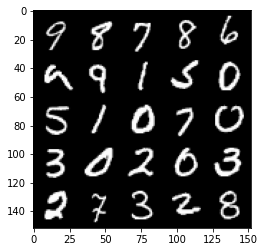

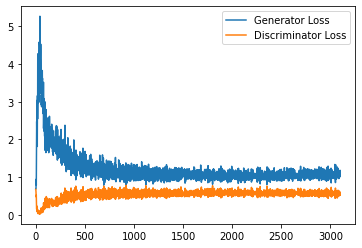

Step 62500: Generator loss: 1.0827501705884934, discriminator loss: 0.5678291980624199


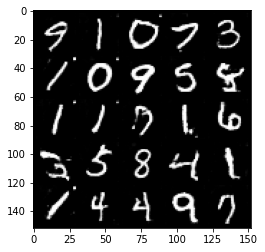

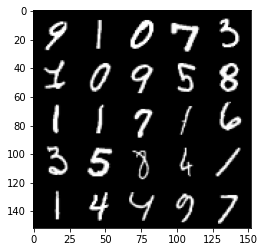

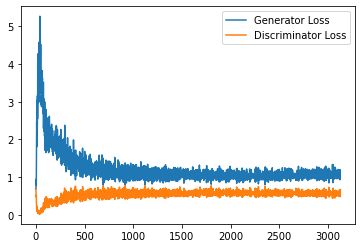

Step 63000: Generator loss: 1.08561339199543, discriminator loss: 0.5586114389896393


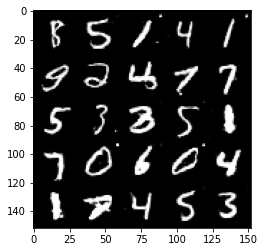

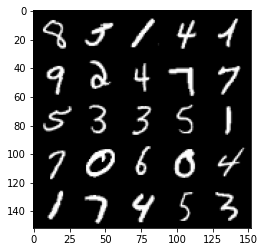

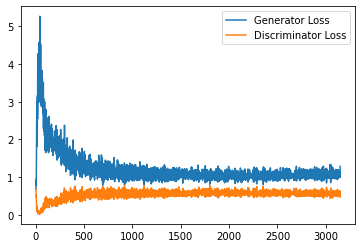

Step 63500: Generator loss: 1.1084722676277161, discriminator loss: 0.5622334687113761


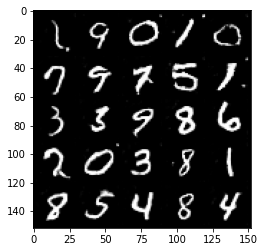

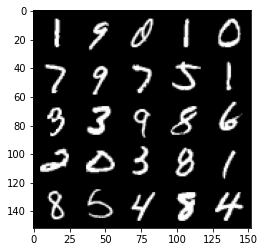

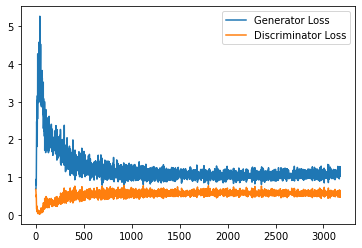

Step 64000: Generator loss: 1.0865781803131103, discriminator loss: 0.5694262208938599


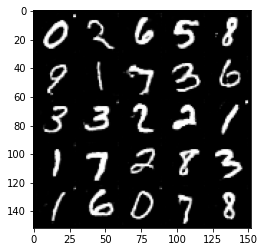

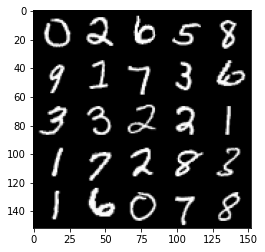

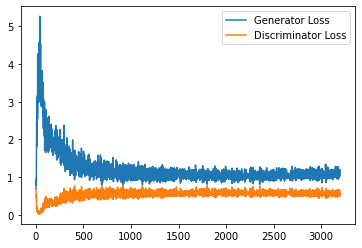

Step 64500: Generator loss: 1.0914132145643234, discriminator loss: 0.5721483523249626


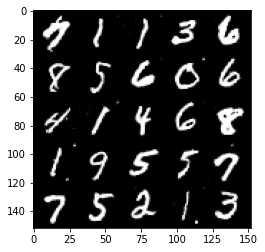

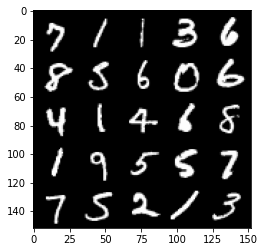

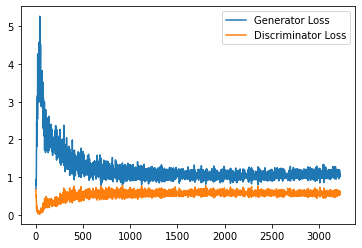

Step 65000: Generator loss: 1.0965077178478242, discriminator loss: 0.5596626244783401


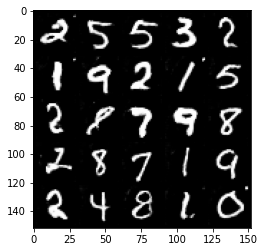

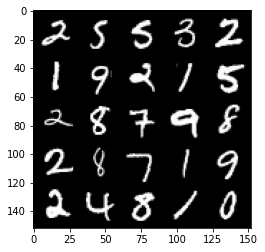

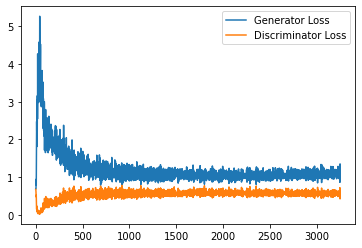

Step 65500: Generator loss: 1.0931329952478408, discriminator loss: 0.5652990860939026


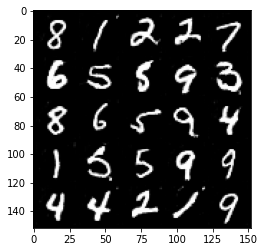

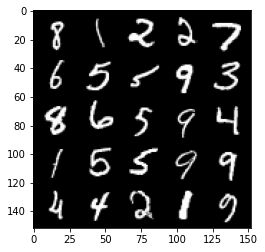

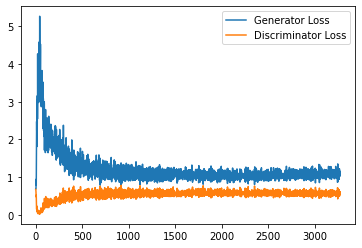

Step 66000: Generator loss: 1.0766502202749253, discriminator loss: 0.5636955515742302


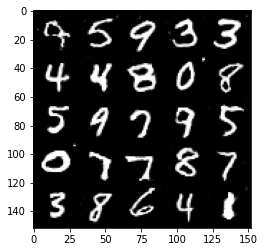

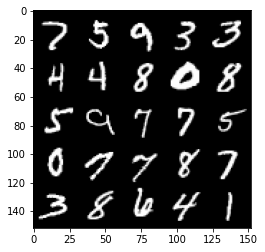

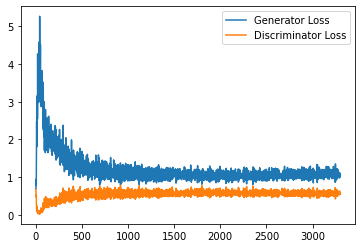

Step 66500: Generator loss: 1.0790107078552247, discriminator loss: 0.5667278990149498


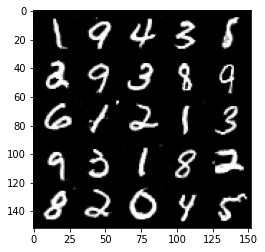

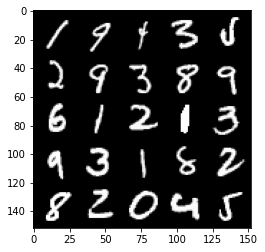

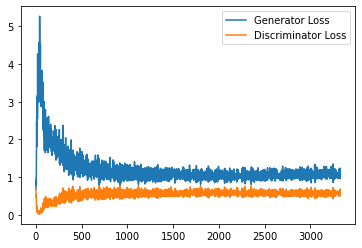

Step 67000: Generator loss: 1.0792919317483902, discriminator loss: 0.566515896320343


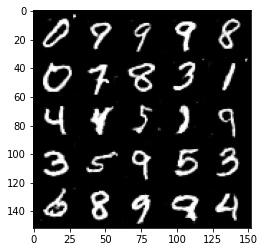

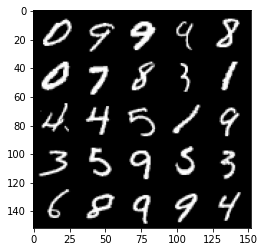

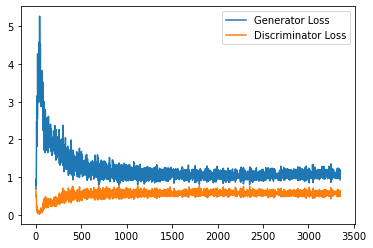

Step 67500: Generator loss: 1.0748602769374846, discriminator loss: 0.5663698118925095


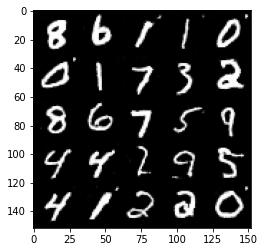

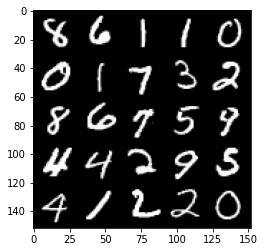

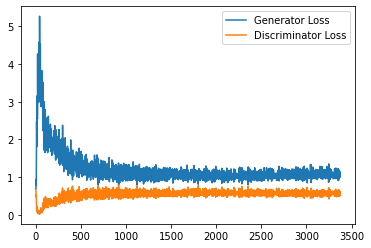

Step 68000: Generator loss: 1.0783785146474838, discriminator loss: 0.5627215983271598


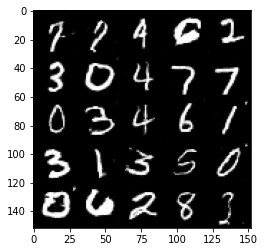

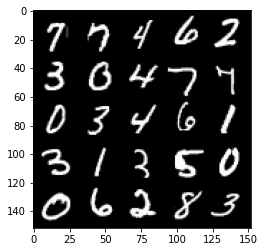

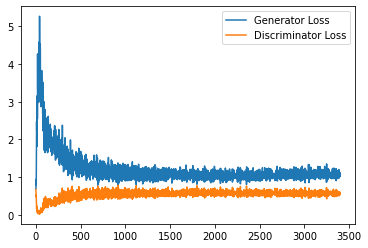

Step 68500: Generator loss: 1.092474711894989, discriminator loss: 0.5656175666451454


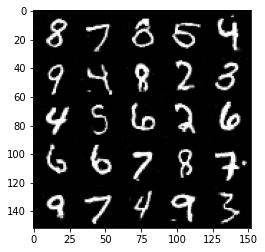

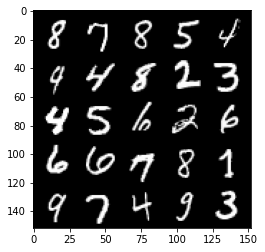

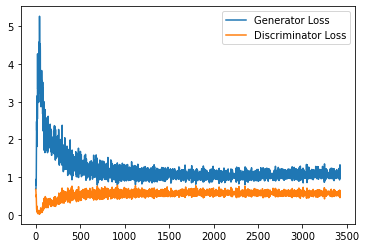

Step 69000: Generator loss: 1.1245587614774704, discriminator loss: 0.5683461564779282


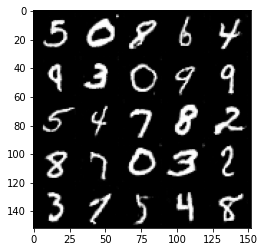

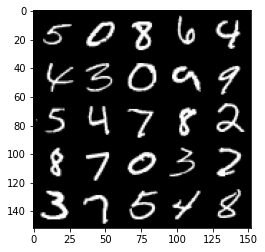

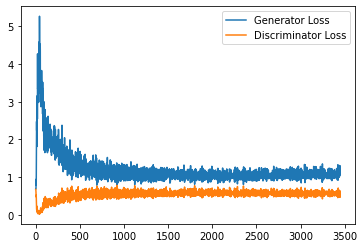

Step 69500: Generator loss: 1.1027518119812012, discriminator loss: 0.5650835635662079


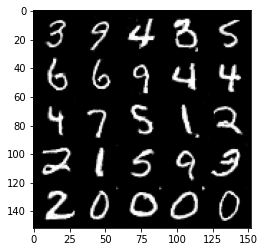

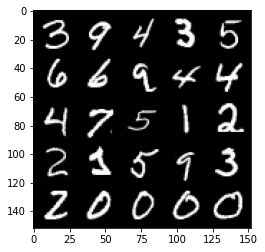

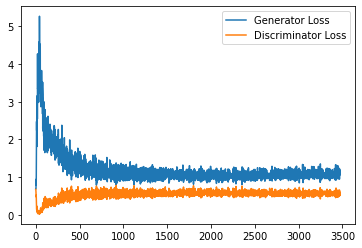

Step 70000: Generator loss: 1.067478523850441, discriminator loss: 0.5663343228697777


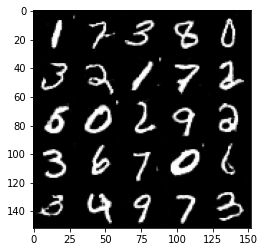

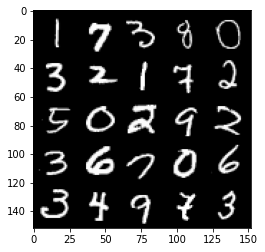

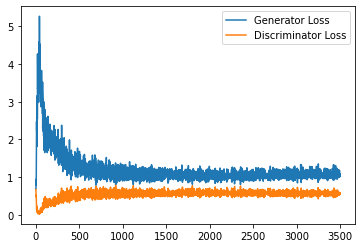

Step 70500: Generator loss: 1.0816649315357207, discriminator loss: 0.5612937654256821


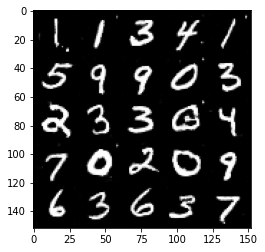

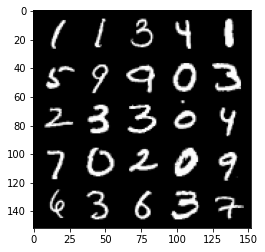

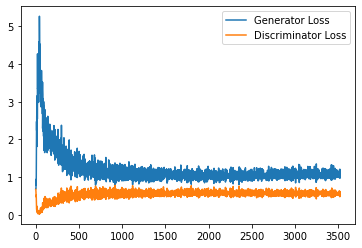

Step 71000: Generator loss: 1.0847629328966142, discriminator loss: 0.5625798766016961


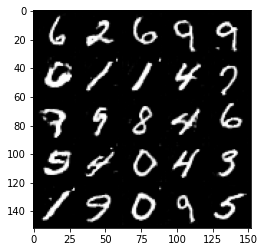

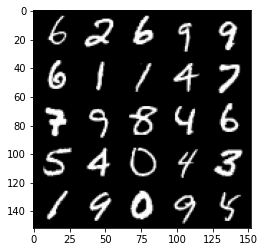

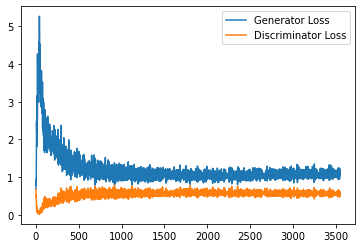

Step 71500: Generator loss: 1.082391389489174, discriminator loss: 0.566145344376564


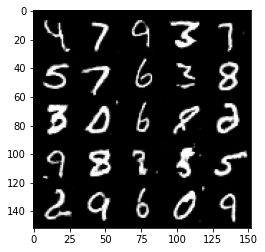

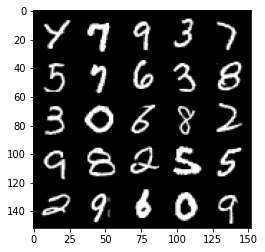

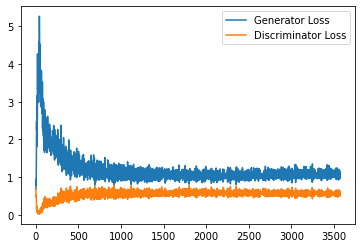

Step 72000: Generator loss: 1.092192634820938, discriminator loss: 0.5661707673668861


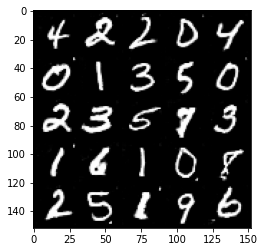

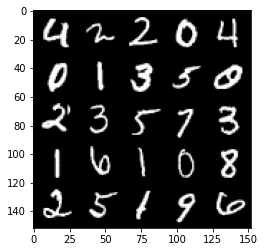

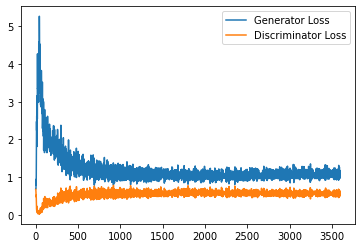

Step 72500: Generator loss: 1.0878768553733826, discriminator loss: 0.5649302572607994


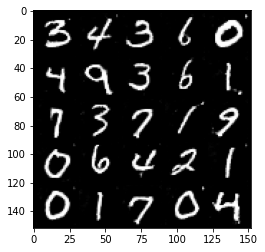

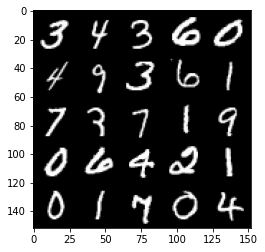

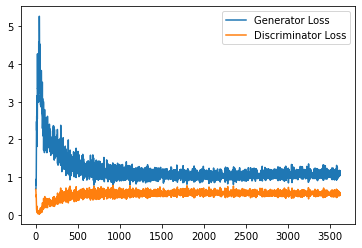

Step 73000: Generator loss: 1.0989452112913132, discriminator loss: 0.568987391769886


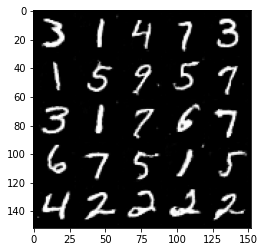

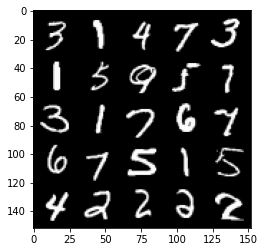

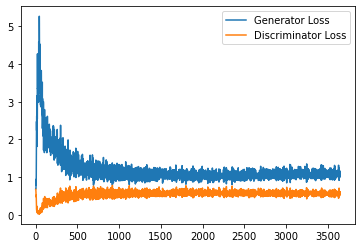

Step 73500: Generator loss: 1.1092533849477768, discriminator loss: 0.5690911334156991


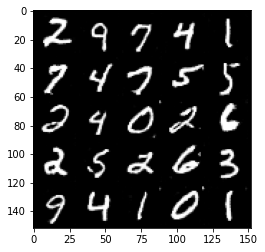

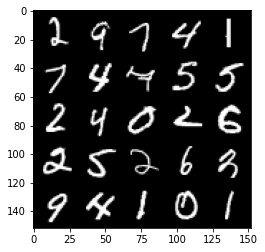

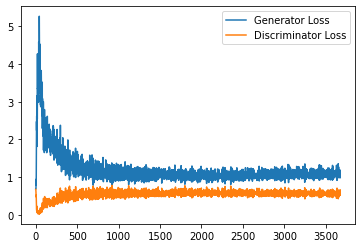

Step 74000: Generator loss: 1.0858593934774399, discriminator loss: 0.5679860088229179


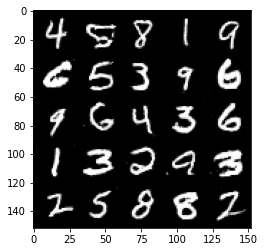

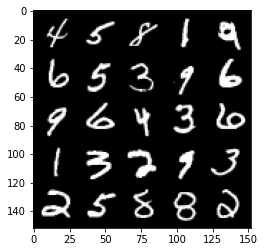

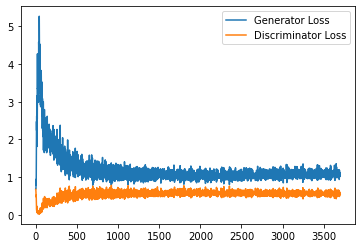

Step 74500: Generator loss: 1.079600040912628, discriminator loss: 0.5628431116938591


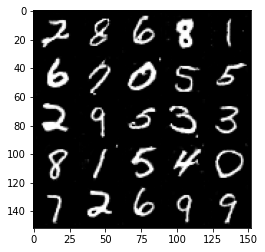

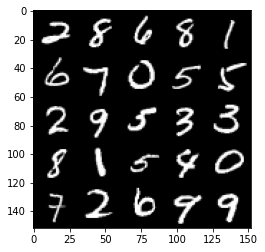

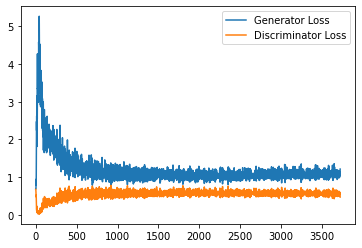

Step 75000: Generator loss: 1.0800302780866622, discriminator loss: 0.5736028597950935


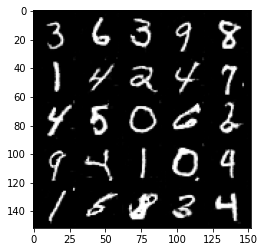

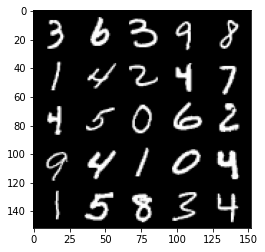

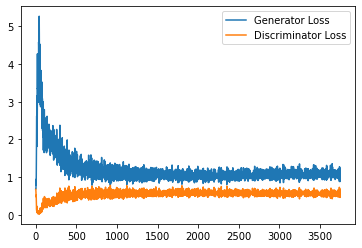

Step 75500: Generator loss: 1.1005545382499695, discriminator loss: 0.5688401427865029


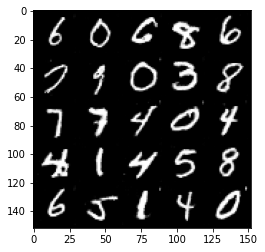

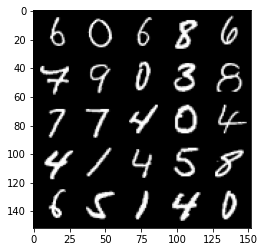

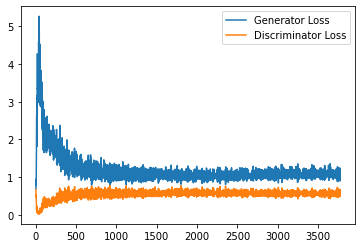

Step 76000: Generator loss: 1.0919273347854614, discriminator loss: 0.5699213153123855


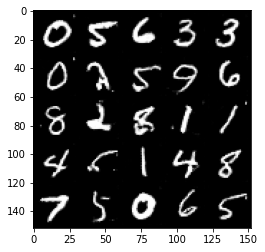

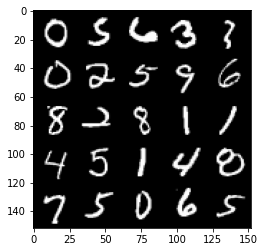

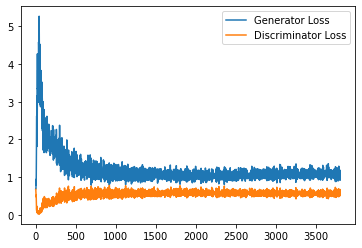

Step 76500: Generator loss: 1.0842673995494843, discriminator loss: 0.5673207680583


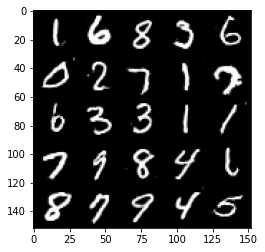

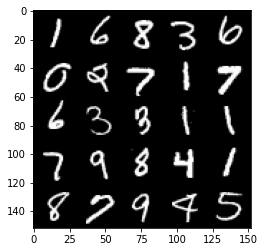

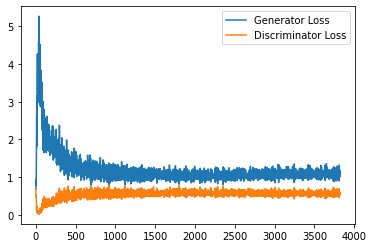

Step 77000: Generator loss: 1.0792706311941147, discriminator loss: 0.5722243489027024


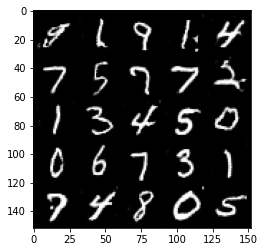

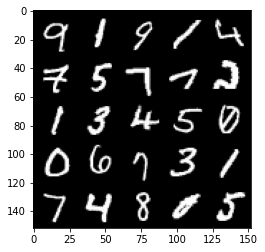

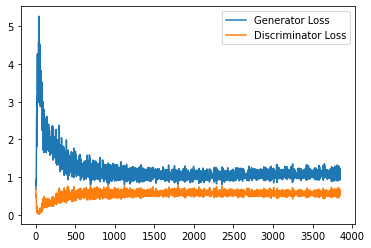

Step 77500: Generator loss: 1.0828586859703064, discriminator loss: 0.5687616084814071


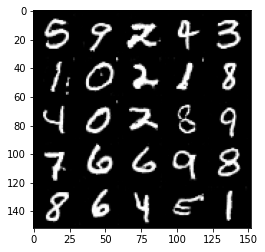

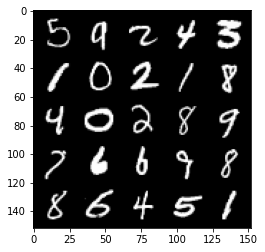

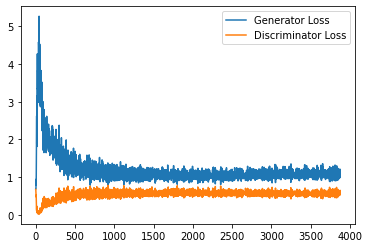

Step 78000: Generator loss: 1.0896993321180344, discriminator loss: 0.5719750166535378


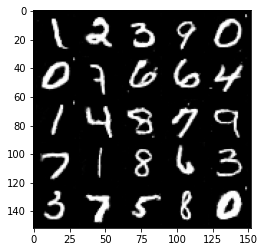

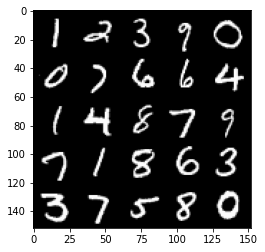

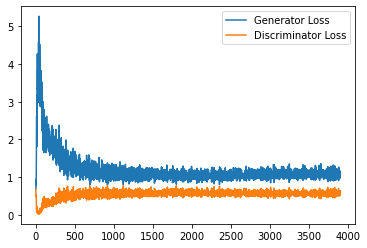

Step 78500: Generator loss: 1.077097188949585, discriminator loss: 0.5674247857928276


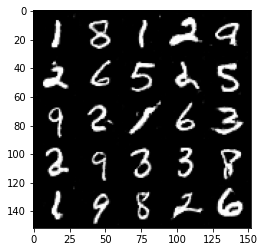

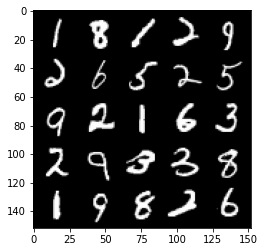

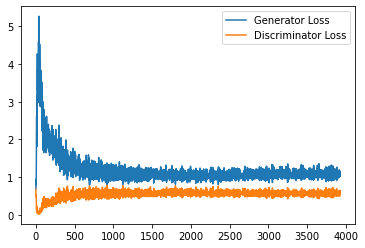

Step 79000: Generator loss: 1.1106434017419815, discriminator loss: 0.5669961874485016


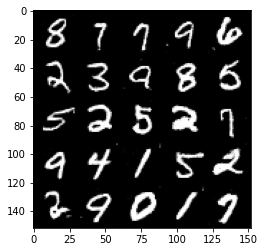

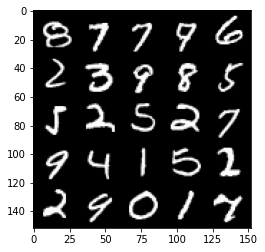

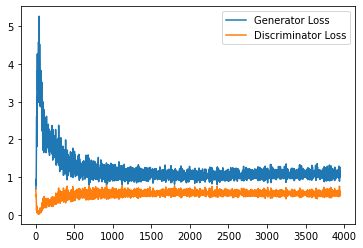

Step 79500: Generator loss: 1.0774090168476105, discriminator loss: 0.5644868317246438


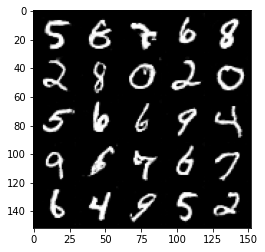

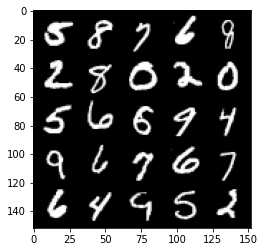

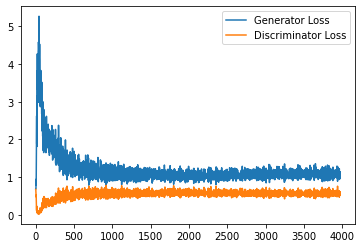

Step 80000: Generator loss: 1.0832916324138642, discriminator loss: 0.5717345969676971


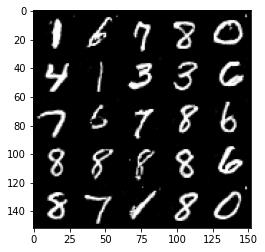

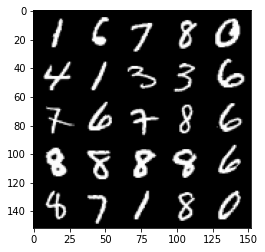

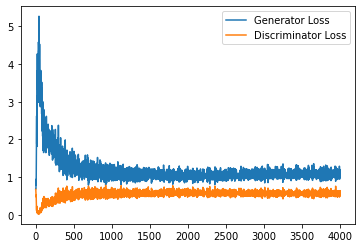

Step 80500: Generator loss: 1.0712133201360703, discriminator loss: 0.5702038567662239


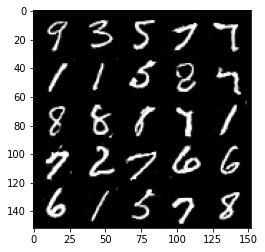

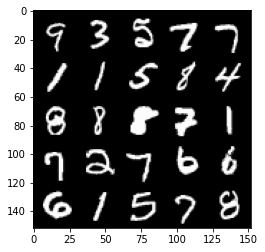

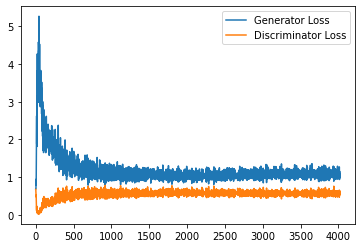

Step 81000: Generator loss: 1.0846716537475587, discriminator loss: 0.5652162846326828


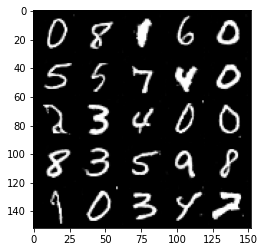

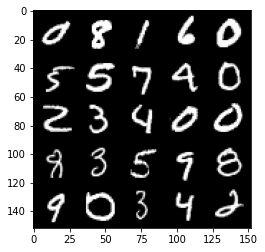

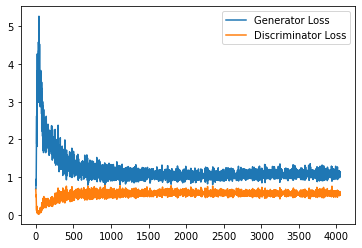

Step 81500: Generator loss: 1.0830230102539062, discriminator loss: 0.5776771987676621


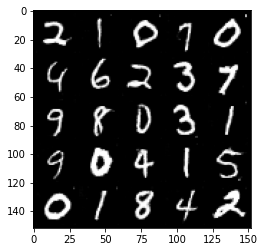

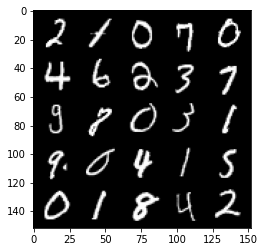

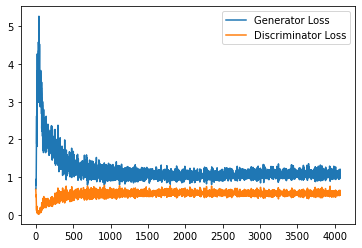

Step 82000: Generator loss: 1.0920185574293138, discriminator loss: 0.5792777398824692


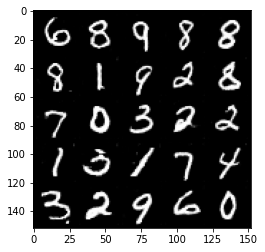

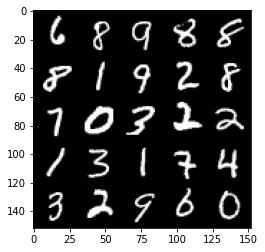

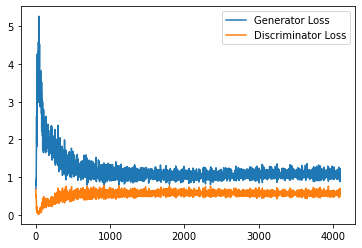

Step 82500: Generator loss: 1.0637635806798935, discriminator loss: 0.5804778326153756


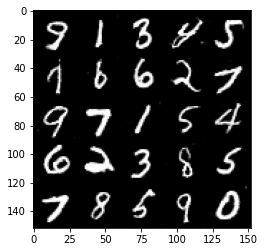

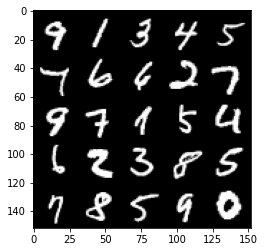

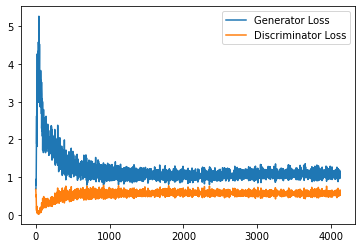

Step 83000: Generator loss: 1.0986622486114501, discriminator loss: 0.5724713458418846


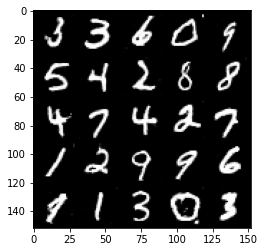

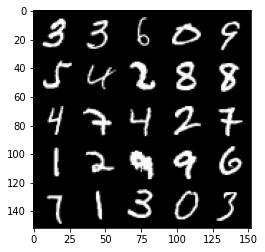

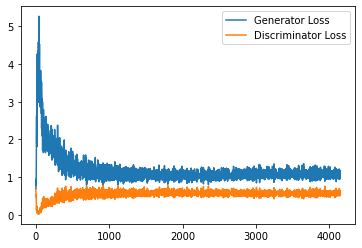

Step 83500: Generator loss: 1.0588484383821488, discriminator loss: 0.582189052939415


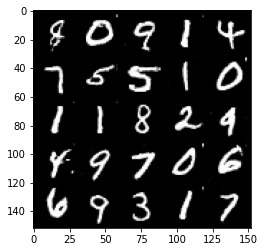

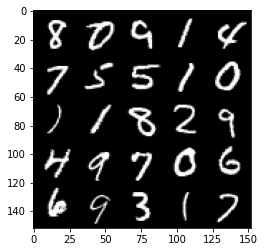

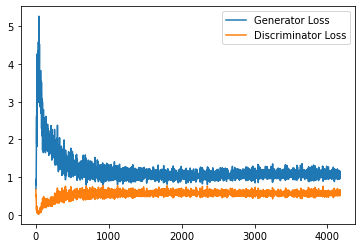

Step 84000: Generator loss: 1.0738622940778733, discriminator loss: 0.5789633984565735


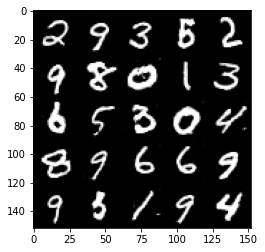

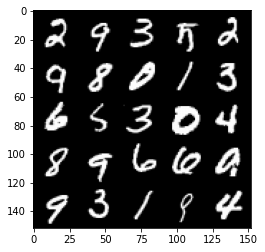

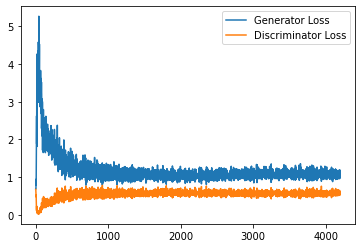

Step 84500: Generator loss: 1.0710546584129335, discriminator loss: 0.5770147062540054


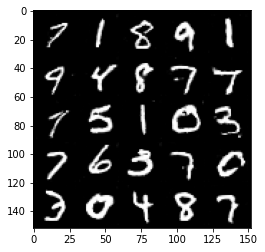

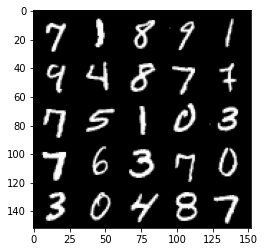

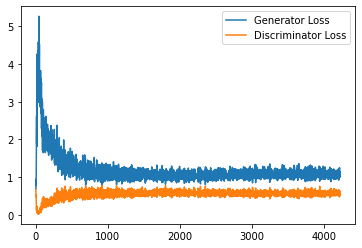

Step 85000: Generator loss: 1.0897758386135101, discriminator loss: 0.582875496327877


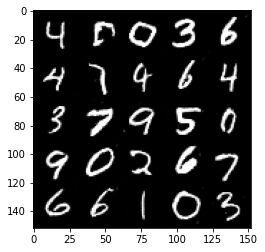

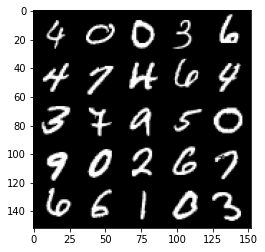

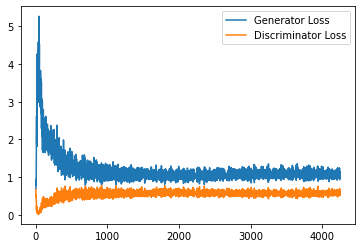

Step 85500: Generator loss: 1.051152982354164, discriminator loss: 0.5896042613387108


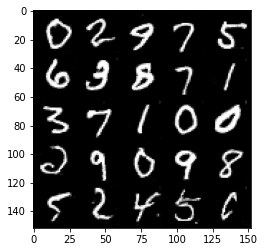

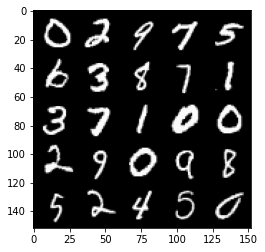

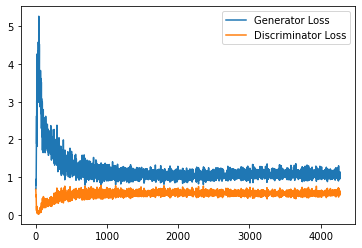

Step 86000: Generator loss: 1.0679937870502472, discriminator loss: 0.5796062854528428


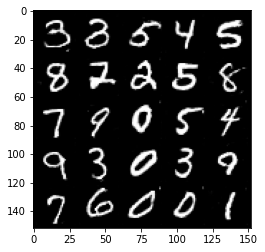

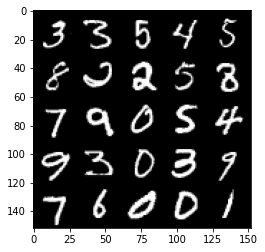

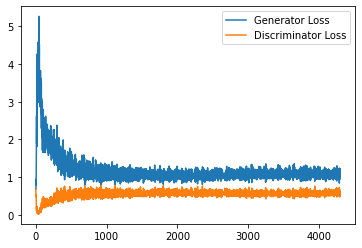

Step 86500: Generator loss: 1.0595890666246415, discriminator loss: 0.5814656930565834


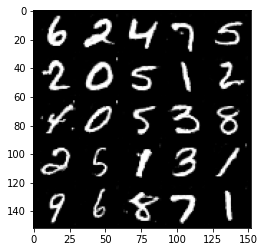

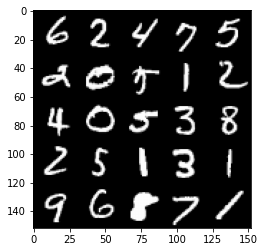

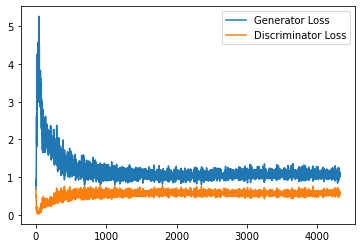

Step 87000: Generator loss: 1.0645278881788254, discriminator loss: 0.5835133764147759


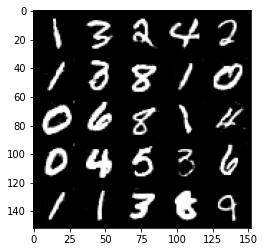

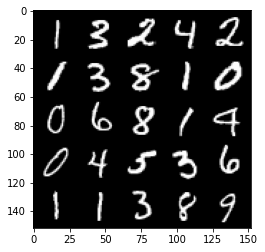

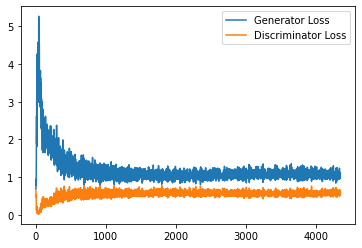

Step 87500: Generator loss: 1.0637995784282683, discriminator loss: 0.589429384291172


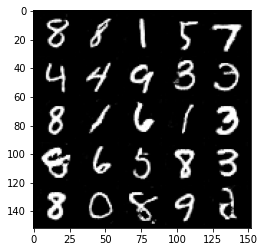

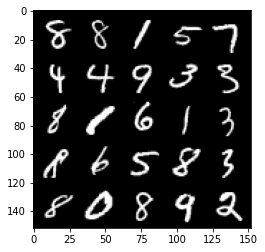

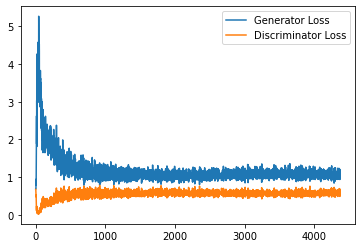

Step 88000: Generator loss: 1.0731477991342544, discriminator loss: 0.5845868614912033


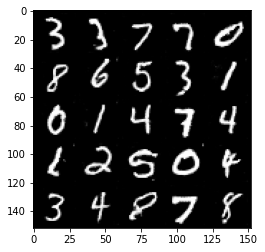

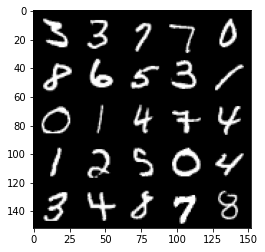

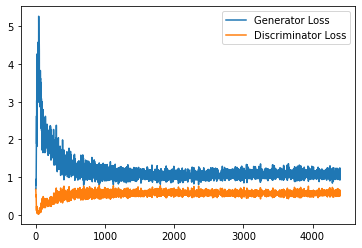

Step 88500: Generator loss: 1.0622450877428056, discriminator loss: 0.5852371075153351


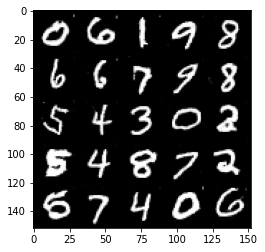

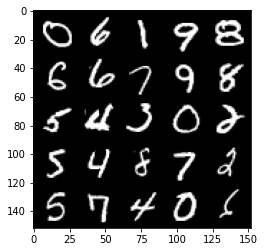

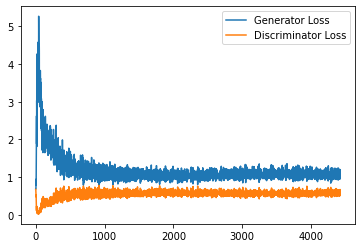

Step 89000: Generator loss: 1.0469019166231155, discriminator loss: 0.589997378885746


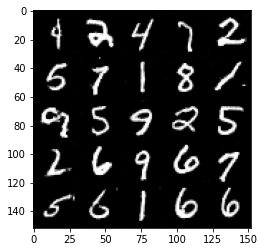

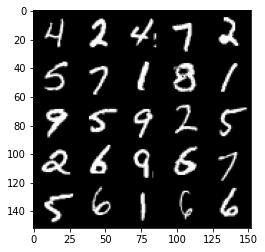

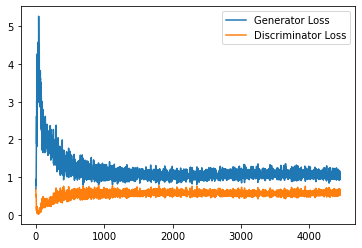

Step 89500: Generator loss: 1.053294601559639, discriminator loss: 0.592814726293087


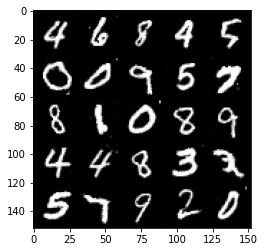

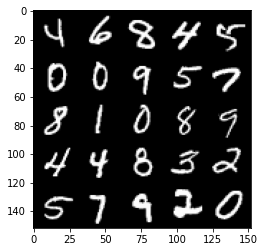

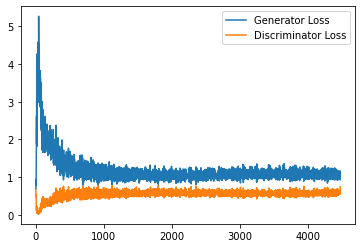

Step 90000: Generator loss: 1.0628960366249085, discriminator loss: 0.5909489231705666


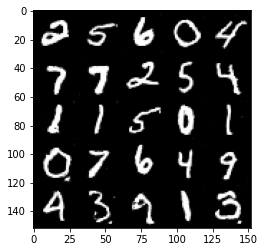

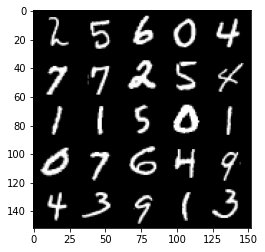

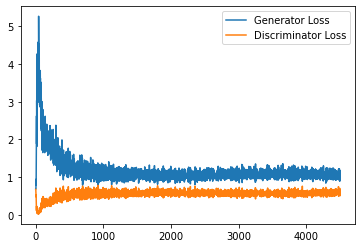

Step 90500: Generator loss: 1.0531359065771102, discriminator loss: 0.5885381329655647


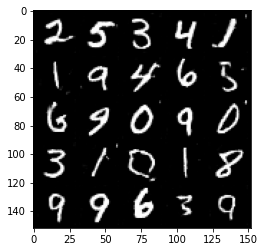

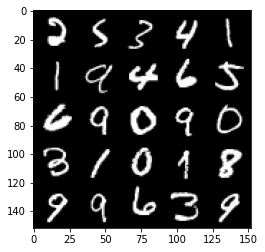

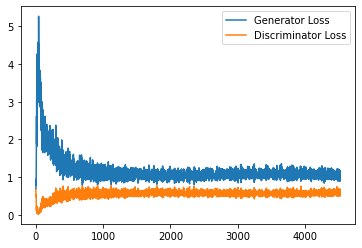

Step 91000: Generator loss: 1.0478298699855804, discriminator loss: 0.5926717647314071


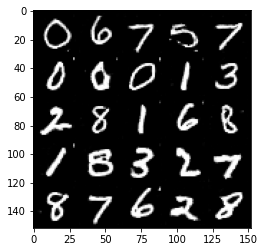

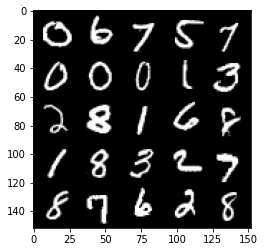

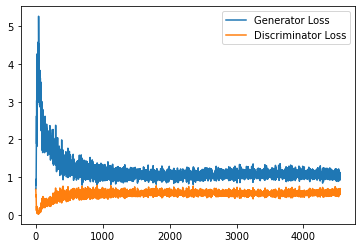

Step 91500: Generator loss: 1.04245623755455, discriminator loss: 0.5872091807126999


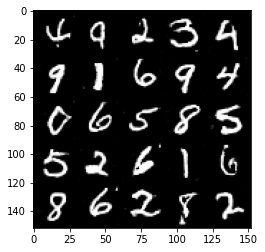

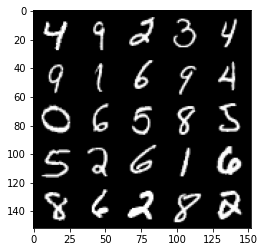

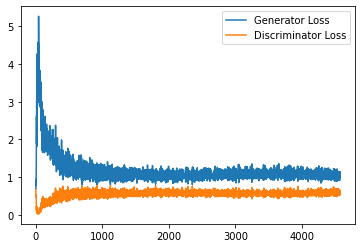

Step 92000: Generator loss: 1.0381961393356323, discriminator loss: 0.5895235625505447


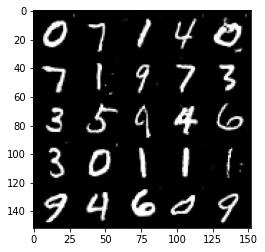

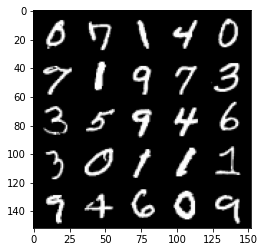

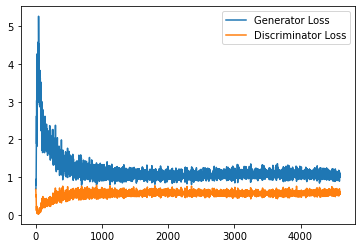

Step 92500: Generator loss: 1.0567379924058915, discriminator loss: 0.5958354052901268


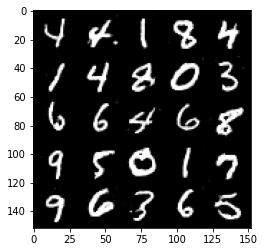

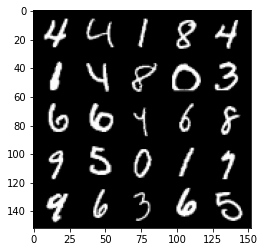

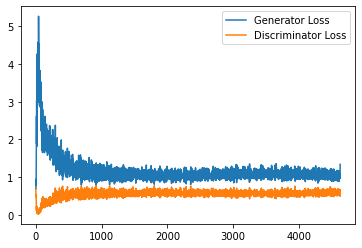

Step 93000: Generator loss: 1.0430609889030455, discriminator loss: 0.5996541922688484


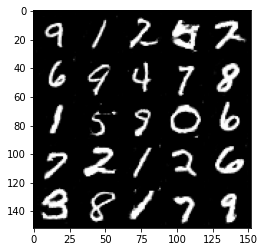

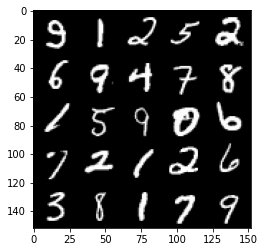

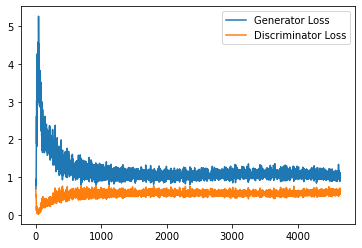

Step 93500: Generator loss: 1.0569698061943054, discriminator loss: 0.5897330214381218


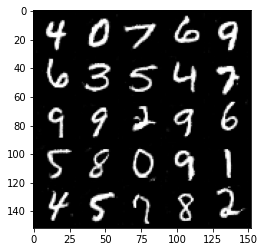

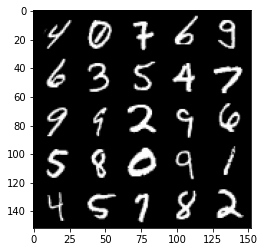

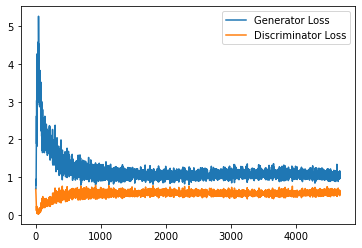

In [13]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [14]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

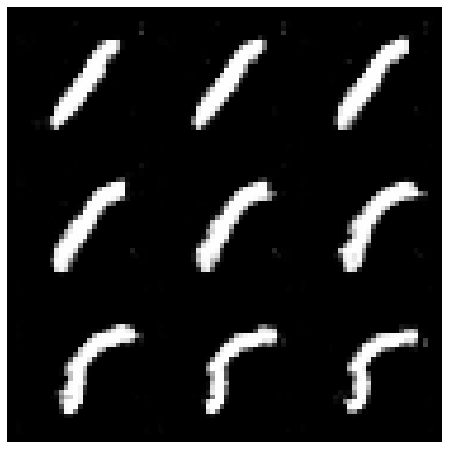

In [15]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

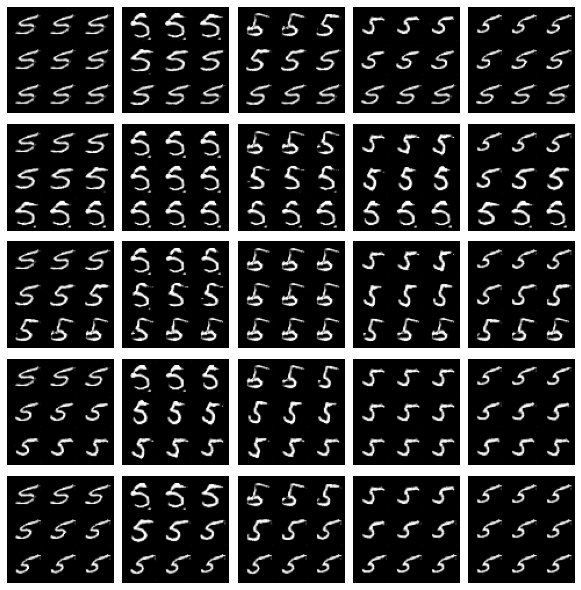

In [16]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()